In [1]:
import logging
logging.getLogger().setLevel(logging.INFO)

In [2]:
!pip install levenshtein

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 174.1/174.1 kB 7.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.0/3.0 MB 54.6 MB/s eta 0:00:00


# Baselines - Antiphones without differncies

## Word Segmentation

INFO:numexpr.utils:NumExpr defaulting to 2 threads.
INFO:root:Number of chants: 13551


/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:629: FutureWarning: The default value for `force_alpha` will change to `True` in 1.4. To suppress this warning, manually set the value of `force_alpha`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:635: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10. Use `force_alpha=True` to keep alpha unchanged.
  warnings.warn(
INFO:root:The SVC model was trained with 9486 training data and 9486 testing data.
INFO:root:From model approach - Selected features: 1000 (only 100 of them will be chosen)
INFO:root:From model approach Train data - First feature occurences: 5337 , Last feature occurences: 192
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:629: FutureWarning: The default value for `force_alpha` will change to `True` in 1.4. To suppress this warning, manually set the value of `force_alpha`.
  warnings.warn(
/usr/local/lib/python3.10/dist-package

------------------------------- Train Scores -------------------------------

		 bacor accuracy and f1
			 accuracy: 96.45%
			 f1: 96.41%

		 NB accuracy and f1
			 accuracy: 95.31%
			 f1: 95.35%

		 Perplexity
			 -1.000000

		 Vocabulary Size
			 size: 15176 unique segments

		 Average Segment Length
			 avgerage: 3.61 tones in one segment

		 Melody Justified With Words
			 words justification: 100.00% of segments
			 segments justification: 100.00% of segments
			 average justification: 100.00% of segments

		 Weighted Top Mode Frequency
			 wtmf: 58.78% of melodies

		 Weighted Unique Final Pitch Count
			 wufpc: 5.70 final pitches for a chant

		 Vocabulary Levenhstein Score
			 vls: 0.89 vocab diversity
------------- Modes Vocabulary Statistics -------------


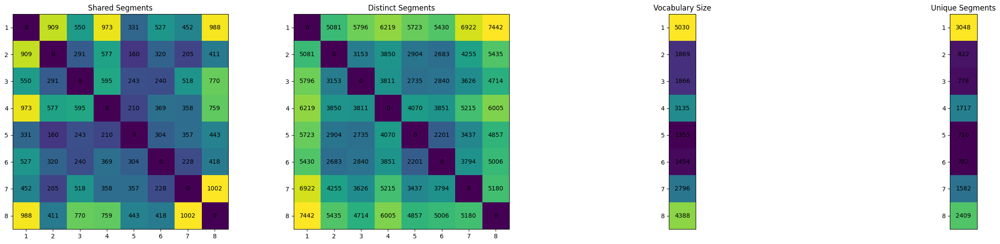

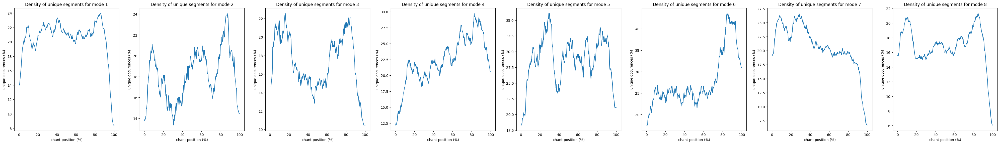

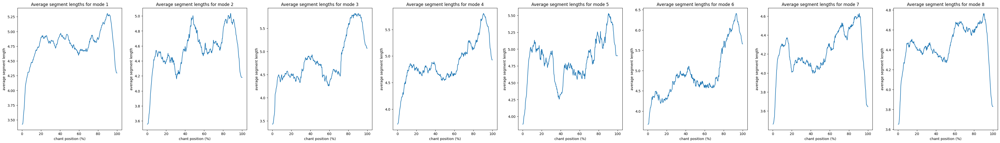

-------------------------------------------------------
----------------------------- Segments Occurences regarding the mode -----------------------------


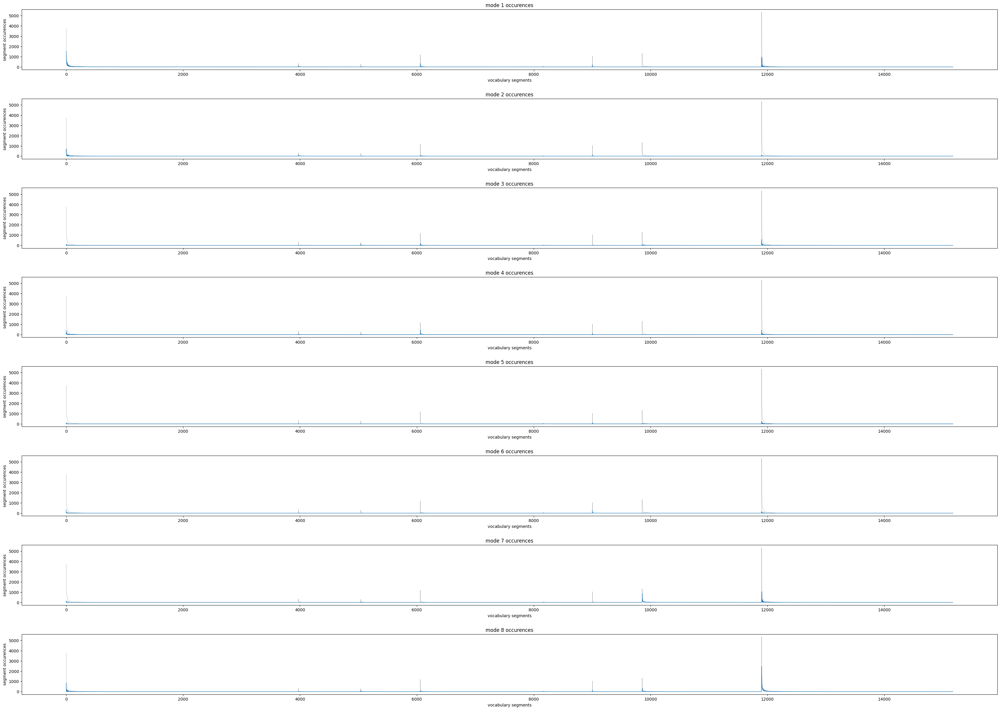

--------------------------------------------------------------------------------------------------
--------------------------------------------------------------------------






INFO:root:The SVC model was trained with 9486 training data and 4065 testing data.
INFO:root:From model approach - Selected features: 1000 (only 100 of them will be chosen)
INFO:root:From model approach Train data - First feature occurences: 5337 , Last feature occurences: 192
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:629: FutureWarning: The default value for `force_alpha` will change to `True` in 1.4. To suppress this warning, manually set the value of `force_alpha`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:635: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10. Use `force_alpha=True` to keep alpha unchanged.
  warnings.warn(
INFO:root:From model approach - reduced bacor accuracy: 88.86%, reduced bacor f1: 88.77% - reduced NB accuracy: 85.81%, reduced NB f1: 85.40%


------------------------------- Test Scores -------------------------------

		 bacor accuracy and f1
			 accuracy: 90.53%
			 f1: 90.38%

		 NB accuracy and f1
			 accuracy: 86.72%
			 f1: 86.98%

		 Perplexity
			 -1.000000

		 Vocabulary Size
			 size: 9201 unique segments

		 Average Segment Length
			 avgerage: 3.63 tones in one segment

		 Melody Justified With Phrases
			 mjww: -100.00% of segments

		 Melody Justified With Words
			 words justification: 100.00% of segments
			 segments justification: 100.00% of segments
			 average justification: 100.00% of segments

		 Weighted Top Mode Frequency
			 wtmf: 60.09% of melodies

		 Weighted Unique Final Pitch Count
			 wufpc: 5.72 final pitches for a chant

		 Vocabulary Levenhstein Score
			 vls: 0.90 vocab diversity
------------- Modes Vocabulary Statistics -------------


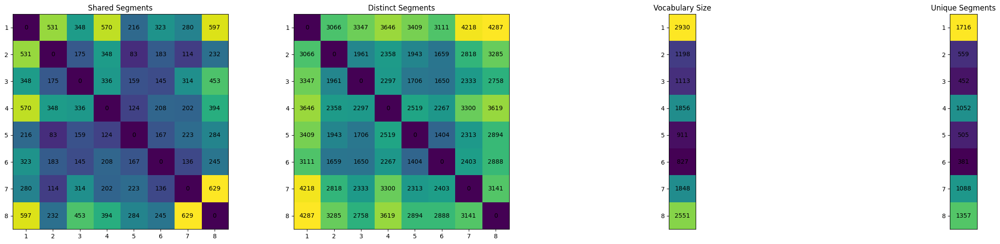

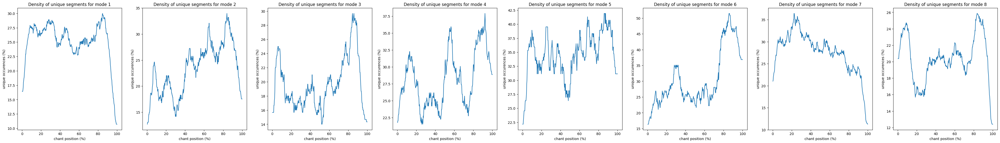

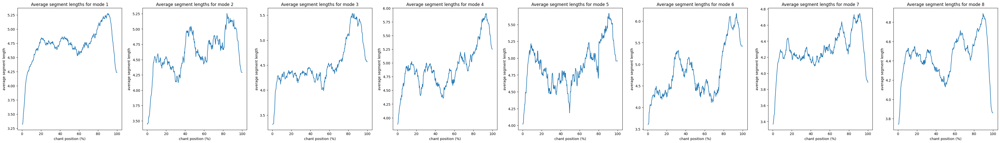

-------------------------------------------------------
----------------------------- Segments Occurences regarding the mode -----------------------------


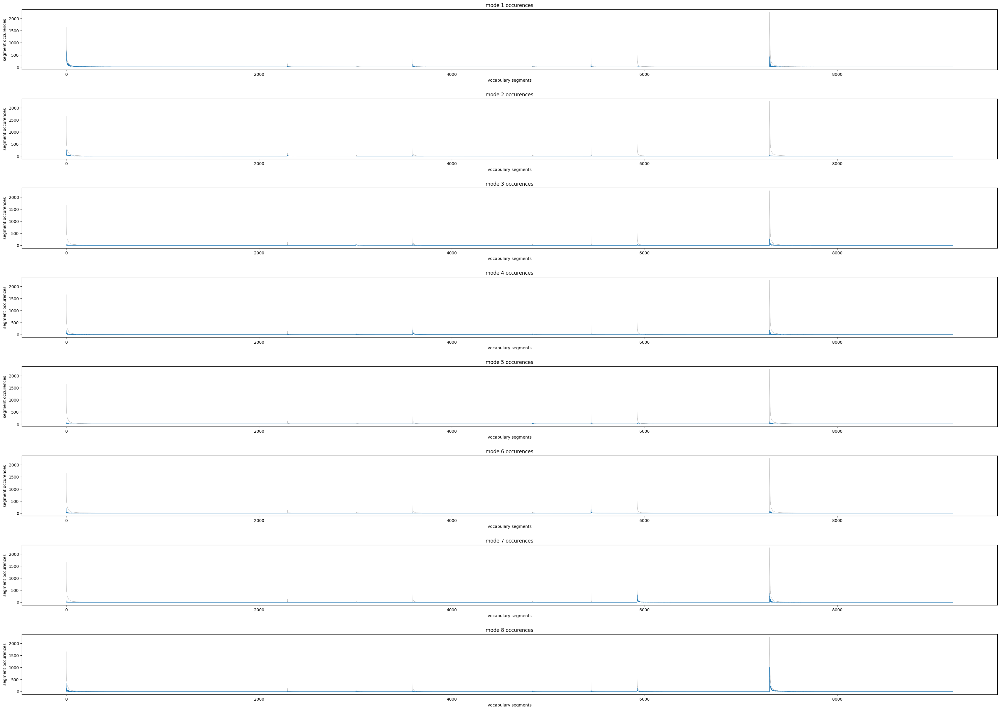

--------------------------------------------------------------------------------------------------
--------------------------------------------------------------------------




Top selected melodies - from model: ['g', 'h', 'f', 'gg', 'd', 'k', 'hg', 'dd', 'gh', 'hgf', 'gf', 'l', 'fg', 'e', 'kk', 'ghg', 'c', 'ff', 'fe', 'cd', 'ef', 'dc', 'fed', 'kj', 'j', 'hgg', 'ghh', 'hh', 'hk', 'jk', 'kjh', 'fghh', 'ee', 'gfe', 'll', 'fh', 'fgh', 'lk', 'fgf', 'efg', 'kh', 'fghg', 'lml', 'ghgf', 'hgh', 'fedd', 'ggg', 'dcdd', 'ghhgg', 'kkk', 'fgg', 'df', 'ddc', 'fedc', 'kkj', 'kl', 'ggh', 'gfgg', 'fd', 'hkj', 'hkk', 'ghgg', 'ed', 'hghg', 'klk', 'kjhg', 'lm', 'ghk', 'cdf', 'cdd', 'jh', 'fef', 'de', 'ffe', 'gghg', 'gfed', 'efgfe', 'hhg', 'ggf', 'ml', 'dcd', 'dfe', 'kjg', 'efgg', 'lj', 'lkj', 'dfedd', 'hgfg', 'def', 'jhg', 'gfg', 'gfedd', 'ggkh', 'gfgh', 'ge', 'ghhg', 'khg', 'm', 'gfghh', 'gfee']


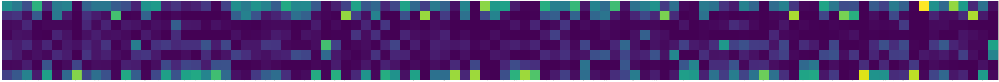

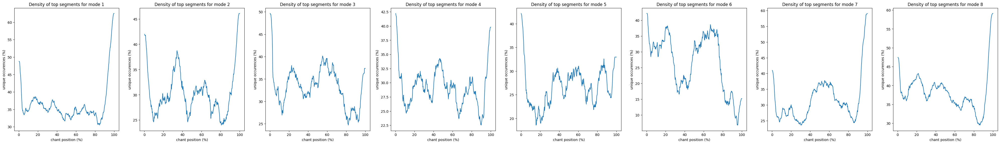





------------------------- Train + Test data charts ----------------------------
------------- Modes Vocabulary Statistics -------------


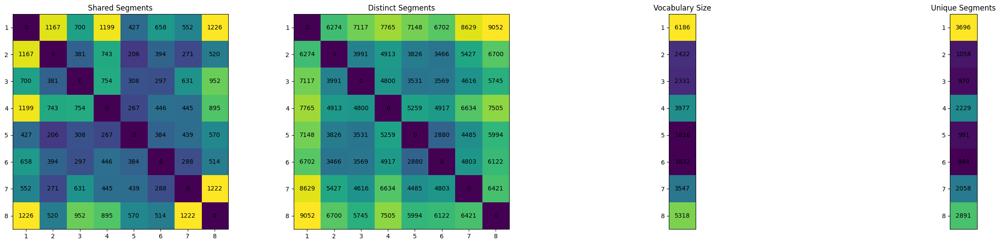

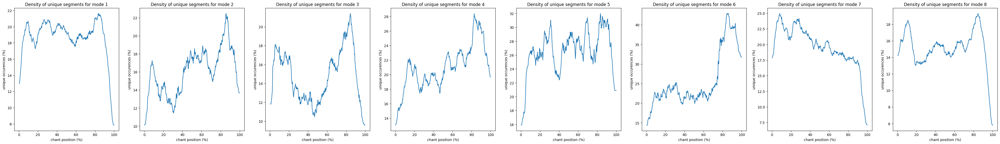

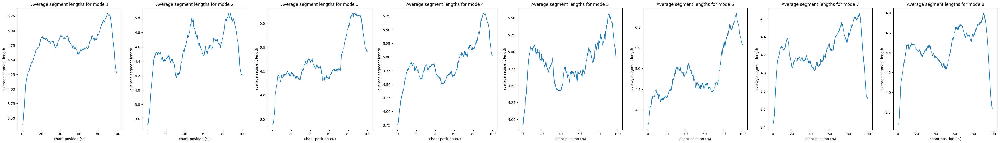

-------------------------------------------------------
------------------------------------------------------------------------


In [3]:
from src.utils.loader import prepare_dataset, load_word_segmentations
from src.eval.pipelines import evaluation_pipeline


# Get Data
_, y = prepare_dataset()
y_train, y_test = y[:9486].tolist(), y[9486:].tolist()
word_segmentations = load_word_segmentations()
train_segmentation, test_segmentation = word_segmentations[:9486], word_segmentations[9486:]
# Evaluate model
bacor_model = evaluation_pipeline(
    train_segmentation, y_train, test_segmentation, y_test,
    max_features_from_model = 100, include_additative = False, fe_occurence_coef=10)

INFO:root:Number of chants: 13551


/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:629: FutureWarning: The default value for `force_alpha` will change to `True` in 1.4. To suppress this warning, manually set the value of `force_alpha`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:635: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10. Use `force_alpha=True` to keep alpha unchanged.
  warnings.warn(
INFO:root:The SVC model was trained with 9486 training data and 9486 testing data.
INFO:root:From model approach - Selected features: 1000 (only 100 of them will be chosen)
INFO:root:From model approach Train data - First feature occurences: 5336 , Last feature occurences: 183
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:629: FutureWarning: The default value for `force_alpha` will change to `True` in 1.4. To suppress this warning, manually set the value of `force_alpha`.
  warnings.warn(
/usr/local/lib/python3.10/dist-package

------------------------------- Train Scores -------------------------------

		 bacor accuracy and f1
			 accuracy: 96.65%
			 f1: 96.62%

		 NB accuracy and f1
			 accuracy: 95.46%
			 f1: 95.49%

		 Perplexity
			 -1.000000

		 Vocabulary Size
			 size: 18313 unique segments

		 Average Segment Length
			 avgerage: 3.61 tones in one segment

		 Melody Justified With Words
			 words justification: 100.00% of segments
			 segments justification: 100.00% of segments
			 average justification: 100.00% of segments

		 Weighted Top Mode Frequency
			 wtmf: 60.08% of melodies

		 Weighted Unique Final Pitch Count
			 wufpc: 6.21 final pitches for a chant

		 Vocabulary Levenhstein Score
			 vls: 0.91 vocab diversity
------------- Modes Vocabulary Statistics -------------


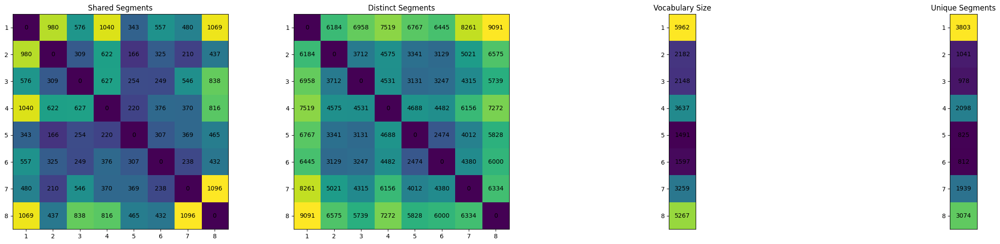

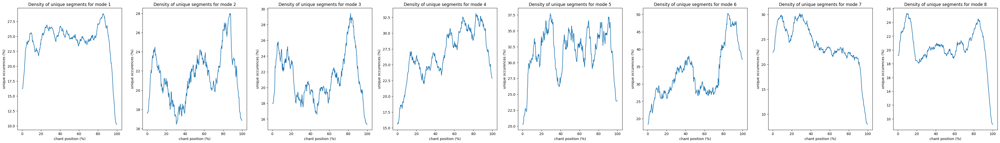

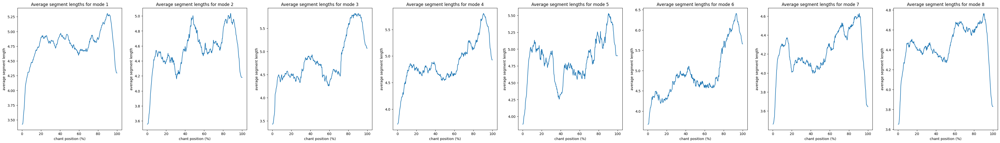

-------------------------------------------------------
----------------------------- Segments Occurences regarding the mode -----------------------------


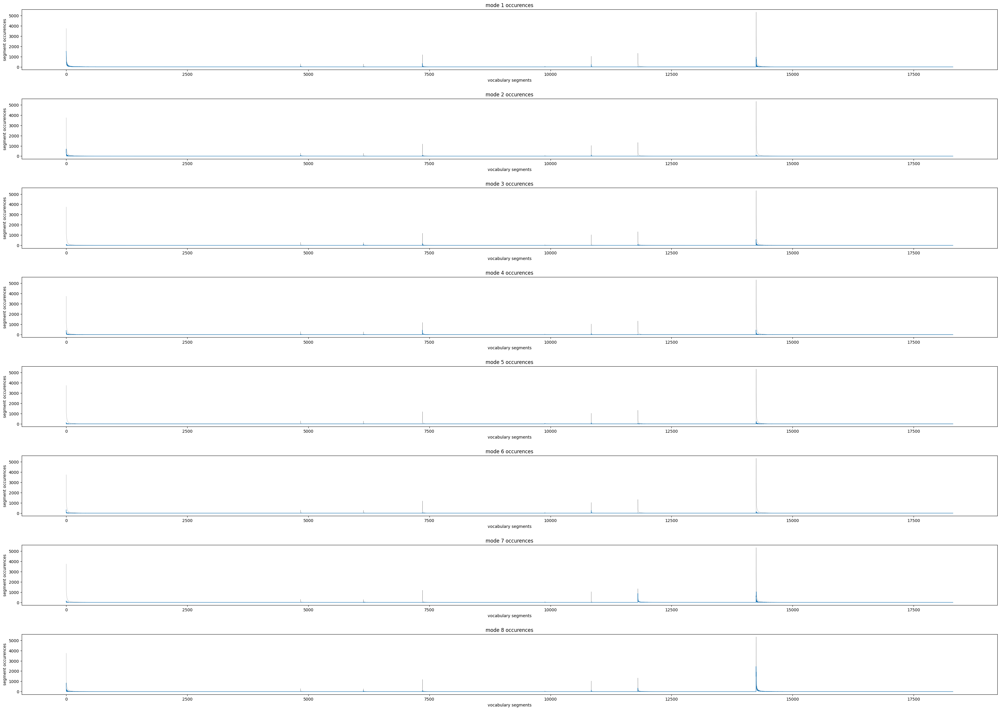

--------------------------------------------------------------------------------------------------
--------------------------------------------------------------------------






INFO:root:The SVC model was trained with 9486 training data and 4065 testing data.
INFO:root:From model approach - Selected features: 1000 (only 100 of them will be chosen)
INFO:root:From model approach Train data - First feature occurences: 5336 , Last feature occurences: 183
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:629: FutureWarning: The default value for `force_alpha` will change to `True` in 1.4. To suppress this warning, manually set the value of `force_alpha`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:635: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10. Use `force_alpha=True` to keep alpha unchanged.
  warnings.warn(
INFO:root:From model approach - reduced bacor accuracy: 88.19%, reduced bacor f1: 88.11% - reduced NB accuracy: 85.22%, reduced NB f1: 84.84%


------------------------------- Test Scores -------------------------------

		 bacor accuracy and f1
			 accuracy: 90.28%
			 f1: 90.16%

		 NB accuracy and f1
			 accuracy: 86.57%
			 f1: 86.84%

		 Perplexity
			 -1.000000

		 Vocabulary Size
			 size: 10780 unique segments

		 Average Segment Length
			 avgerage: 3.63 tones in one segment

		 Melody Justified With Phrases
			 mjww: -100.00% of segments

		 Melody Justified With Words
			 words justification: 100.00% of segments
			 segments justification: 100.00% of segments
			 average justification: 100.00% of segments

		 Weighted Top Mode Frequency
			 wtmf: 61.50% of melodies

		 Weighted Unique Final Pitch Count
			 wufpc: 6.22 final pitches for a chant

		 Vocabulary Levenhstein Score
			 vls: 0.91 vocab diversity
------------- Modes Vocabulary Statistics -------------


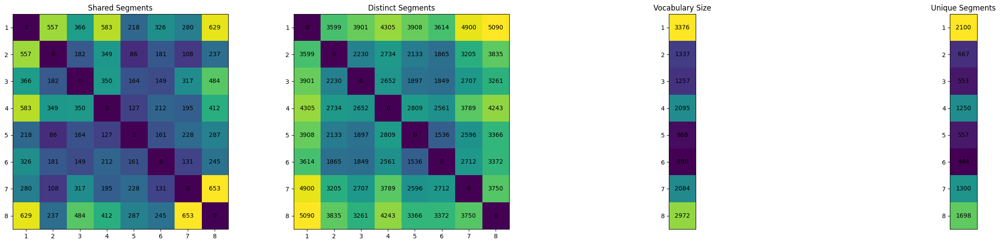

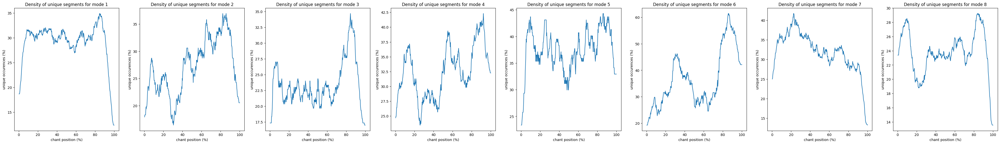

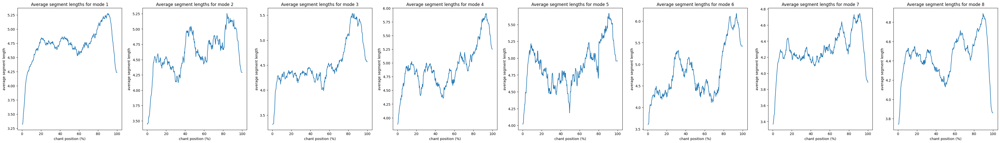

-------------------------------------------------------
----------------------------- Segments Occurences regarding the mode -----------------------------


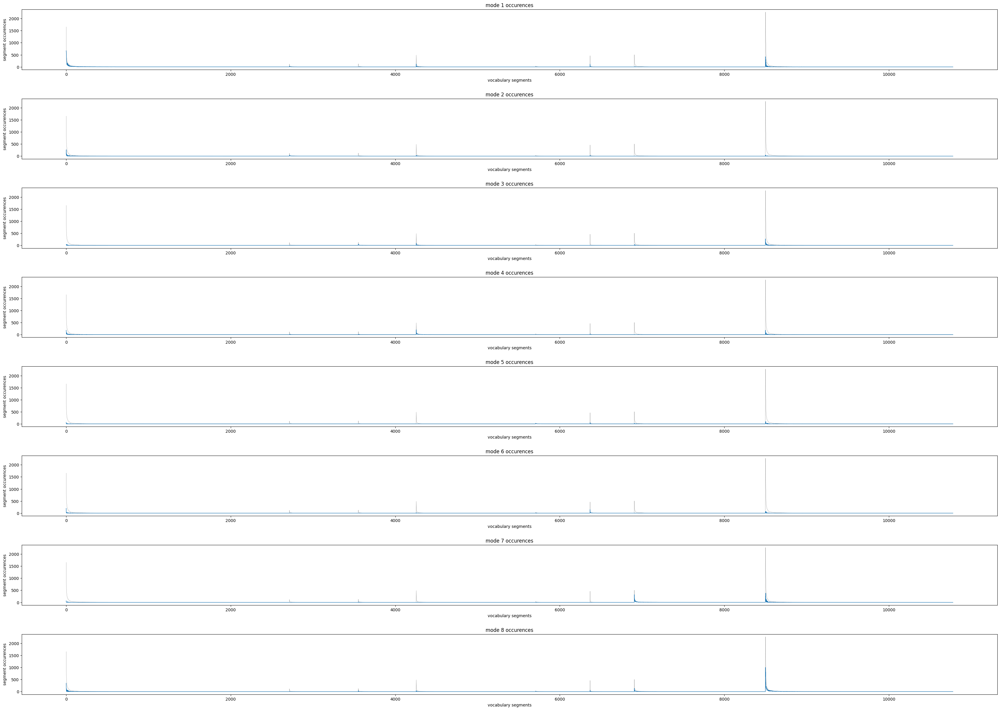

--------------------------------------------------------------------------------------------------
--------------------------------------------------------------------------




Top selected melodies - from model: ['g', 'h', 'f', 'gg', 'd', 'k', 'hg', 'dd', 'gh', 'hgf', 'l', 'e', 'fg', 'kk', 'gf', 'c', 'ff', 'ghg', 'ef', 'cd', 'fe', 'j', 'hh', 'ghh', 'kj', 'fed', 'dc', 'jk', 'hk', 'ee', 'fghh', 'hgg', 'll', 'kjh', 'gfe', 'fh', 'fgh', 'efg', 'fgf', 'ggg', 'fghg', 'lml', 'kh', 'hgh', 'dcdd', 'kkk', 'ghgf', 'df', 'ghhgg', 'fedd', 'kl', 'fgg', 'kkj', 'ggh', 'gfgg', 'gF', 'ddc', 'hkk', 'fd', 'hkj', 'lm', 'hG', 'fedc', 'ghk', 'klk', 'cdf', 'de', 'fef', 'hghg', 'jh', 'gfed', 'efgfe', 'ffe', 'ed', 'cdd', 'dfedd', 'efgg', 'kjhg', 'hhg', 'gghg', 'ml', 'dcd', 'def', 'ghgg', 'lj', 'fE', 'lkj', 'hgfg', 'ggkh', 'dfe', 'kjg', 'ggf', 'm', 'jhg', 'dC', 'gfedd', 'fff', 'ddd', 'khg', 'gfgh']


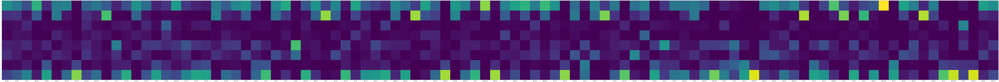

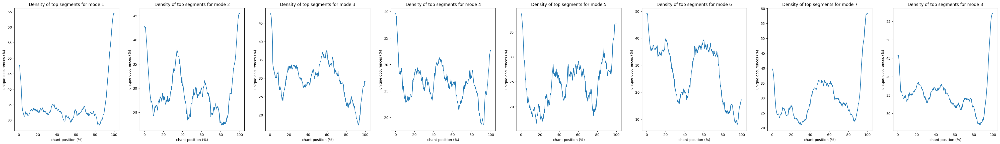





------------------------- Train + Test data charts ----------------------------
------------- Modes Vocabulary Statistics -------------


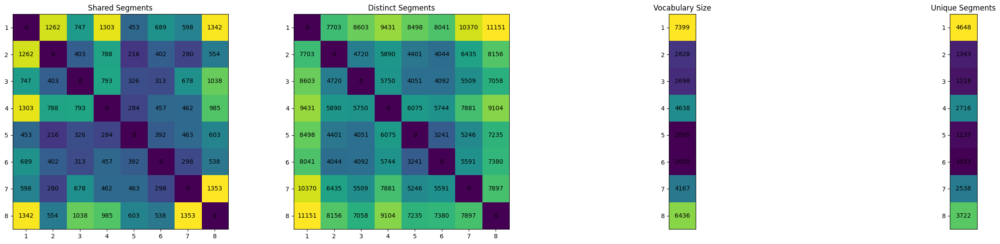

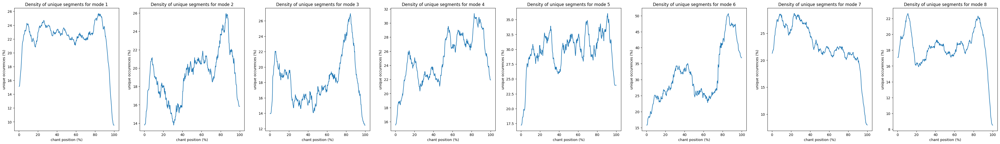

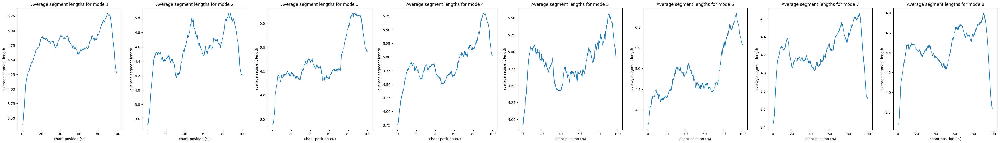

-------------------------------------------------------
------------------------------------------------------------------------


In [4]:
from src.utils.loader import prepare_dataset, load_word_segmentations
from src.eval.pipelines import evaluation_pipeline


# Get Data
_, y = prepare_dataset()
y_train, y_test = y[:9486].tolist(), y[9486:].tolist()
word_segmentations = load_word_segmentations(liquescents=True)
train_segmentation, test_segmentation = word_segmentations[:9486], word_segmentations[9486:]
# Evaluate model
bacor_model = evaluation_pipeline(
    train_segmentation, y_train, test_segmentation, y_test,
    max_features_from_model = 100, include_additative = False, fe_occurence_coef=10)

## Random Segmentation

INFO:root:Number of chants: 13551


/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:629: FutureWarning: The default value for `force_alpha` will change to `True` in 1.4. To suppress this warning, manually set the value of `force_alpha`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:635: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10. Use `force_alpha=True` to keep alpha unchanged.
  warnings.warn(
INFO:root:The SVC model was trained with 9486 training data and 9486 testing data.
INFO:root:From model approach - Selected features: 1000 (only 100 of them will be chosen)
INFO:root:From model approach Train data - First feature occurences: 2542 , Last feature occurences: 116
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:629: FutureWarning: The default value for `force_alpha` will change to `True` in 1.4. To suppress this warning, manually set the value of `force_alpha`.
  warnings.warn(
/usr/local/lib/python3.10/dist-package

------------------------------- Train Scores -------------------------------

		 bacor accuracy and f1
			 accuracy: 95.42%
			 f1: 95.36%

		 NB accuracy and f1
			 accuracy: 94.01%
			 f1: 94.07%

		 Perplexity
			 -1.000000

		 Vocabulary Size
			 size: 23979 unique segments

		 Average Segment Length
			 avgerage: 4.28 tones in one segment

		 Melody Justified With Words
			 words justification: 32.28% of segments
			 segments justification: 27.23% of segments
			 average justification: 29.75% of segments

		 Weighted Top Mode Frequency
			 wtmf: 60.95% of melodies

		 Weighted Unique Final Pitch Count
			 wufpc: 5.74 final pitches for a chant

		 Vocabulary Levenhstein Score
			 vls: 0.91 vocab diversity
------------- Modes Vocabulary Statistics -------------


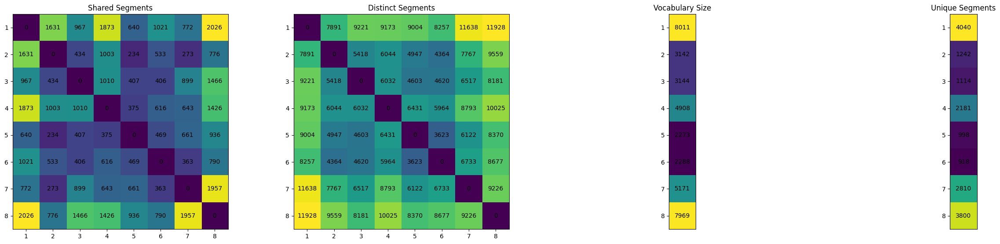

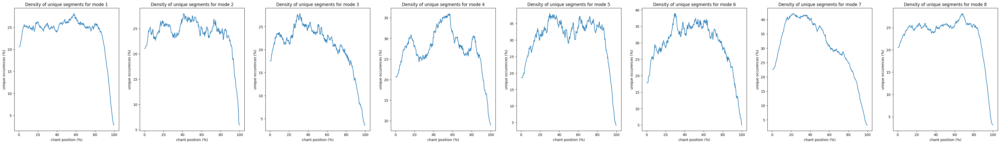

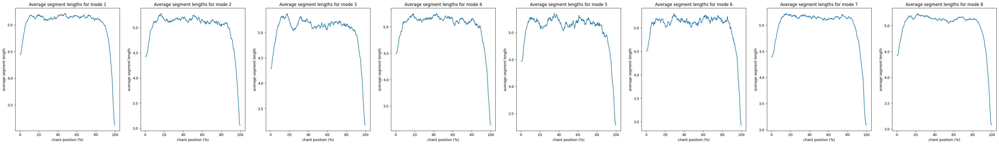

-------------------------------------------------------
----------------------------- Segments Occurences regarding the mode -----------------------------


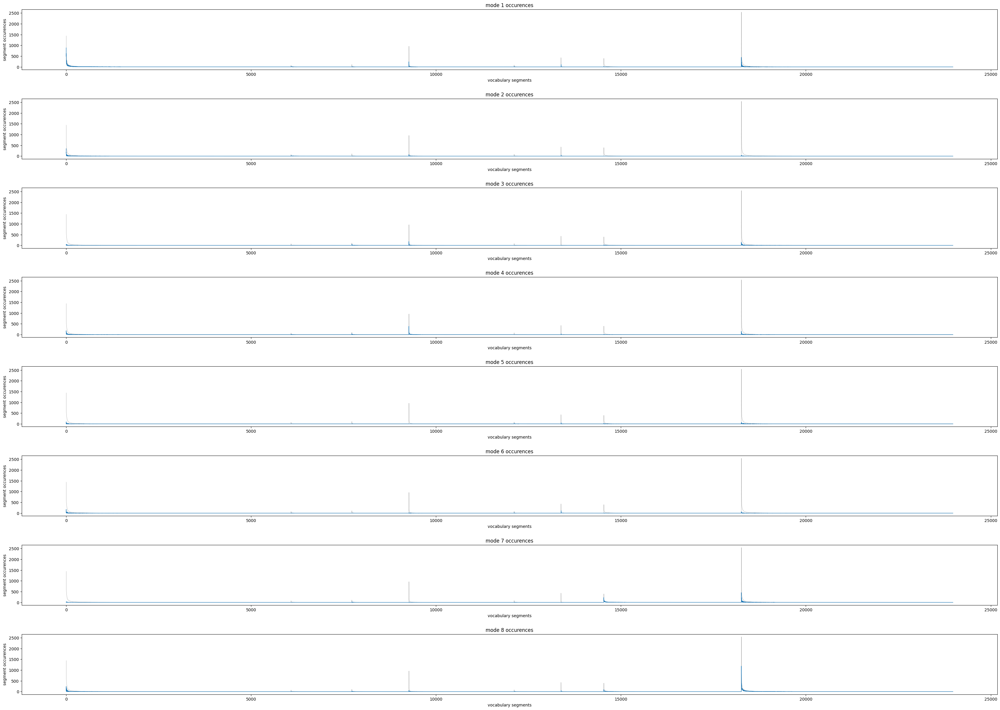

--------------------------------------------------------------------------------------------------
--------------------------------------------------------------------------






INFO:root:The SVC model was trained with 9486 training data and 4065 testing data.
INFO:root:From model approach - Selected features: 1000 (only 100 of them will be chosen)
INFO:root:From model approach Train data - First feature occurences: 2542 , Last feature occurences: 116
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:629: FutureWarning: The default value for `force_alpha` will change to `True` in 1.4. To suppress this warning, manually set the value of `force_alpha`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:635: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10. Use `force_alpha=True` to keep alpha unchanged.
  warnings.warn(
INFO:root:From model approach - reduced bacor accuracy: 77.17%, reduced bacor f1: 76.72% - reduced NB accuracy: 74.56%, reduced NB f1: 72.93%


------------------------------- Test Scores -------------------------------

		 bacor accuracy and f1
			 accuracy: 80.89%
			 f1: 80.24%

		 NB accuracy and f1
			 accuracy: 74.83%
			 f1: 76.34%

		 Perplexity
			 -1.000000

		 Vocabulary Size
			 size: 14232 unique segments

		 Average Segment Length
			 avgerage: 4.26 tones in one segment

		 Melody Justified With Phrases
			 mjww: 59.03% of segments

		 Melody Justified With Words
			 words justification: 31.98% of segments
			 segments justification: 27.25% of segments
			 average justification: 29.62% of segments

		 Weighted Top Mode Frequency
			 wtmf: 63.39% of melodies

		 Weighted Unique Final Pitch Count
			 wufpc: 5.74 final pitches for a chant

		 Vocabulary Levenhstein Score
			 vls: 0.91 vocab diversity
------------- Modes Vocabulary Statistics -------------


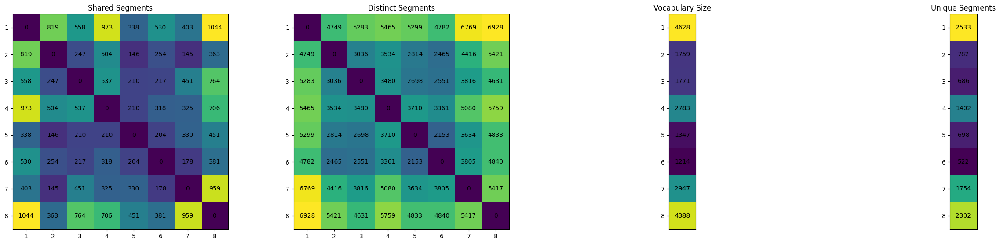

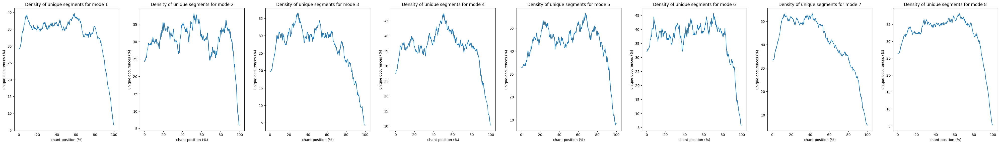

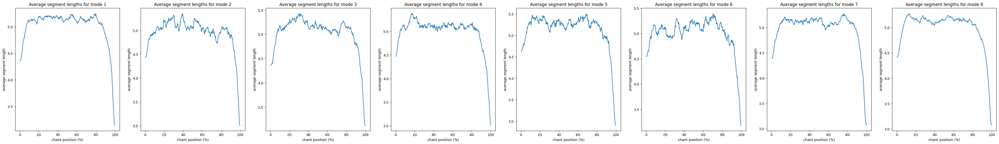

-------------------------------------------------------
----------------------------- Segments Occurences regarding the mode -----------------------------


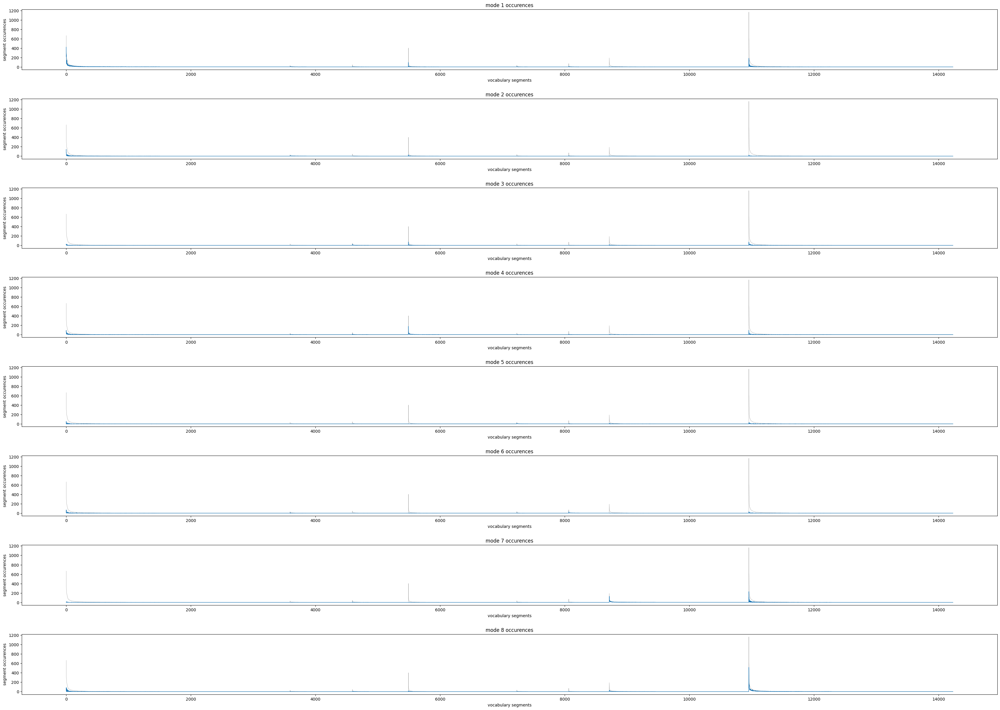

--------------------------------------------------------------------------------------------------
--------------------------------------------------------------------------




Top selected melodies - from model: ['g', 'gg', 'd', 'f', 'e', 'dd', 'k', 'hg', 'hgg', 'gf', 'fg', 'fed', 'ghg', 'hgf', 'fe', 'ff', 'ggg', 'edd', 'hh', 'fgh', 'l', 'fedd', 'j', 'kk', 'gfg', 'hgh', 'ed', 'ghgf', 'ee', 'hhg', 'ef', 'kj', 'gfe', 'efg', 'hk', 'fgf', 'ggh', 'fgg', 'cd', 'dc', 'df', 'ghh', 'gfgh', 'gff', 'ghk', 'ggf', 'jhg', 'kjh', 'hhgg', 'kl', 'fghg', 'ddd', 'kkk', 'dcd', 'lk', 'cdd', 'de', 'gfed', 'fghh', 'hghg', 'ghhg', 'jk', 'fff', 'khg', 'll', 'fd', 'fgfe', 'hhh', 'kkj', 'hkk', 'ffe', 'ghgfg', 'jhgg', 'gfgg', 'fee', 'ddc', 'hggg', 'efgf', 'def', 'cdf', 'ede', 'defg', 'hgfe', 'jkl', 'fef', 'hgfgh', 'kjhg', 'dcdd', 'ghgg', 'edc', 'fh', 'ghf', 'ffg', 'ggk', 'edcd', 'efgg', 'fedc', 'fgfed', 'fggh', 'hgff']


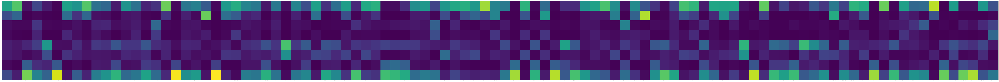

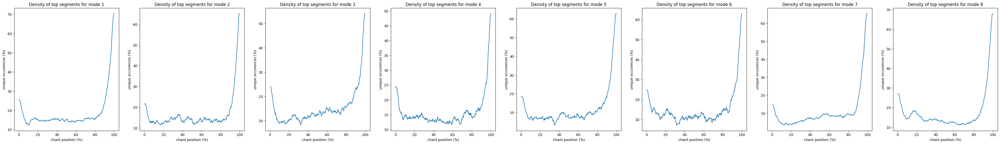





------------------------- Train + Test data charts ----------------------------
------------- Modes Vocabulary Statistics -------------


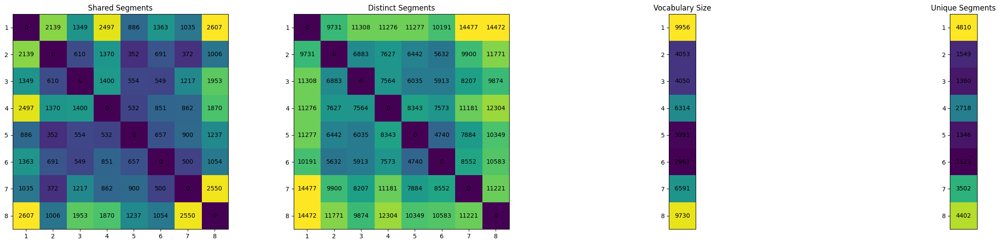

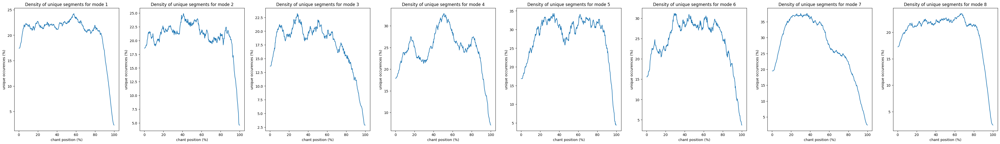

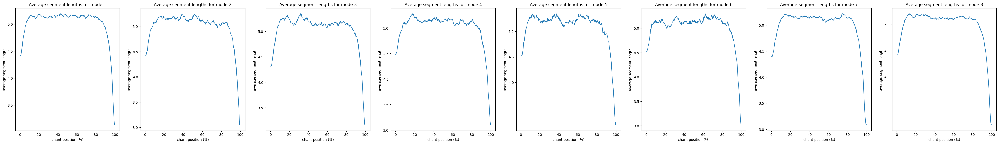

-------------------------------------------------------
------------------------------------------------------------------------


In [5]:
from src.utils.loader import prepare_dataset
from src.eval.pipelines import evaluation_pipeline
from src.models.random_model import RandomModel

# Get Data
X, y = prepare_dataset()
X_train, y_train = X[:int(0.9*9486)].tolist(), y[:int(0.9*9486)].tolist()
X_dev, y_dev = X[int(0.9*9486):9486].tolist(), y[int(0.9*9486):9486].tolist()
X_test, y_test = X[9486:].tolist(), y[9486:].tolist()
# Init model
model = RandomModel(1, 7)
# Predictions
mjwp_score = model.get_mjwp_score()
X_train = X_train+X_dev
y_train = y_train+y_dev
train_segmentation, train_perplexity = model.predict_segments(X_train)
test_segmentation, test_perplexity = model.predict_segments(X_test)

# Evaluate model
bacor_model = evaluation_pipeline(
    train_segmentation, y_train, test_segmentation, y_test, -1, -1, mjwp_score,
    max_features_from_model = 100, include_additative = False, fe_occurence_coef=10)

## N grams

### 4-gram

INFO:root:Number of chants: 13551


/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:629: FutureWarning: The default value for `force_alpha` will change to `True` in 1.4. To suppress this warning, manually set the value of `force_alpha`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:635: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10. Use `force_alpha=True` to keep alpha unchanged.
  warnings.warn(
INFO:root:The SVC model was trained with 9486 training data and 9486 testing data.
INFO:root:From model approach - Selected features: 1000 (only 100 of them will be chosen)
INFO:root:From model approach Train data - First feature occurences: 1903 , Last feature occurences: 329
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:629: FutureWarning: The default value for `force_alpha` will change to `True` in 1.4. To suppress this warning, manually set the value of `force_alpha`.
  warnings.warn(
/usr/local/lib/python3.10/dist-package

------------------------------- Train Scores -------------------------------

		 bacor accuracy and f1
			 accuracy: 96.02%
			 f1: 95.97%

		 NB accuracy and f1
			 accuracy: 94.11%
			 f1: 94.21%

		 Perplexity
			 -1.000000

		 Vocabulary Size
			 size: 3097 unique segments

		 Average Segment Length
			 avgerage: 3.89 tones in one segment

		 Melody Justified With Words
			 words justification: 32.09% of segments
			 segments justification: 29.73% of segments
			 average justification: 30.91% of segments

		 Weighted Top Mode Frequency
			 wtmf: 52.90% of melodies

		 Weighted Unique Final Pitch Count
			 wufpc: 5.88 final pitches for a chant

		 Vocabulary Levenhstein Score
			 vls: 1.00 vocab diversity
------------- Modes Vocabulary Statistics -------------


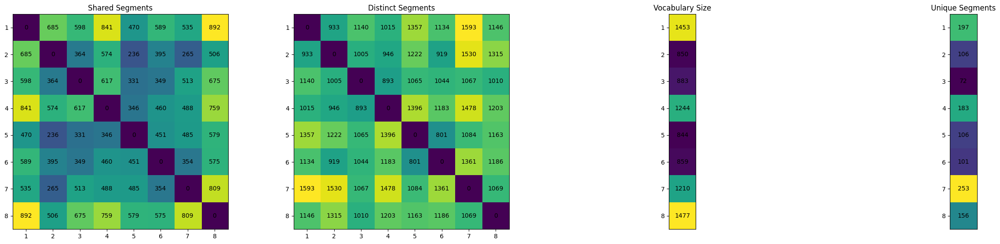

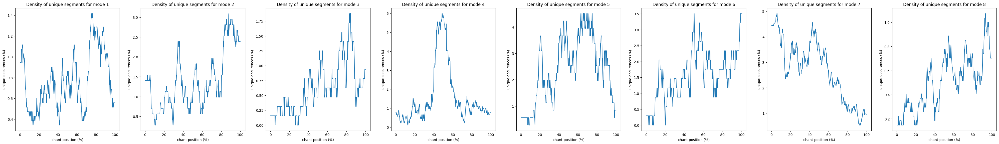

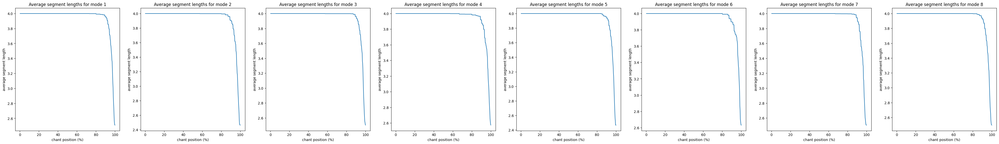

-------------------------------------------------------
----------------------------- Segments Occurences regarding the mode -----------------------------


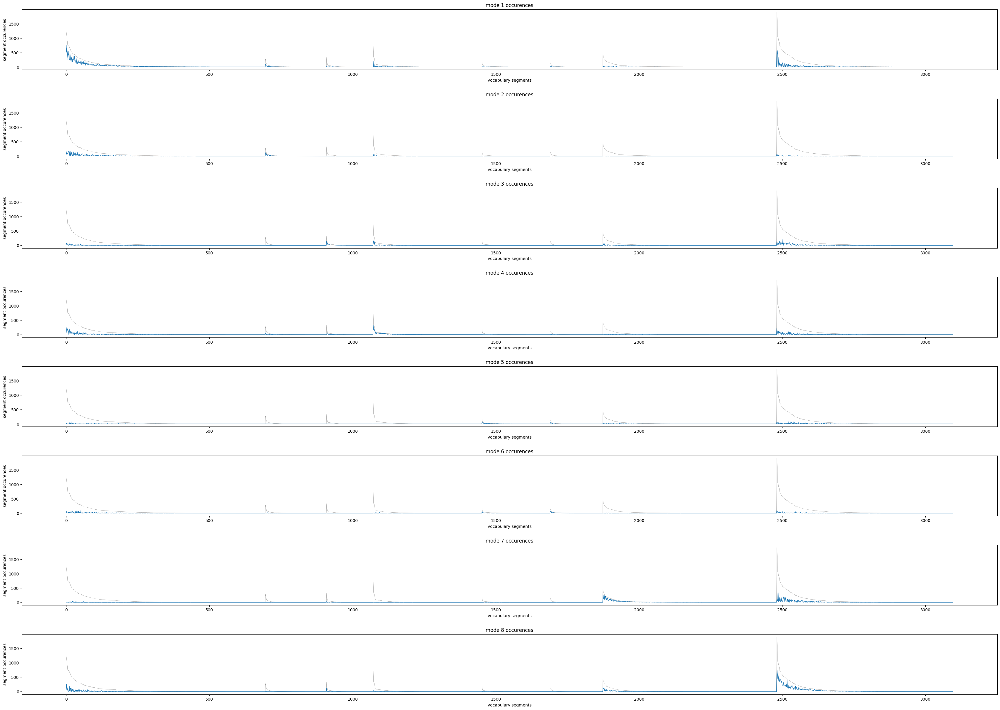

--------------------------------------------------------------------------------------------------
--------------------------------------------------------------------------






INFO:root:The SVC model was trained with 9486 training data and 4065 testing data.
INFO:root:From model approach - Selected features: 1000 (only 100 of them will be chosen)
INFO:root:From model approach Train data - First feature occurences: 1903 , Last feature occurences: 329
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:629: FutureWarning: The default value for `force_alpha` will change to `True` in 1.4. To suppress this warning, manually set the value of `force_alpha`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:635: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10. Use `force_alpha=True` to keep alpha unchanged.
  warnings.warn(
INFO:root:From model approach - reduced bacor accuracy: 90.75%, reduced bacor f1: 90.65% - reduced NB accuracy: 86.96%, reduced NB f1: 86.60%


------------------------------- Test Scores -------------------------------

		 bacor accuracy and f1
			 accuracy: 91.37%
			 f1: 91.25%

		 NB accuracy and f1
			 accuracy: 85.41%
			 f1: 85.75%

		 Perplexity
			 -1.000000

		 Vocabulary Size
			 size: 2511 unique segments

		 Average Segment Length
			 avgerage: 3.89 tones in one segment

		 Melody Justified With Phrases
			 mjww: -100.00% of segments

		 Melody Justified With Words
			 words justification: 31.62% of segments
			 segments justification: 29.51% of segments
			 average justification: 30.56% of segments

		 Weighted Top Mode Frequency
			 wtmf: 53.24% of melodies

		 Weighted Unique Final Pitch Count
			 wufpc: 5.92 final pitches for a chant

		 Vocabulary Levenhstein Score
			 vls: 1.00 vocab diversity
------------- Modes Vocabulary Statistics -------------


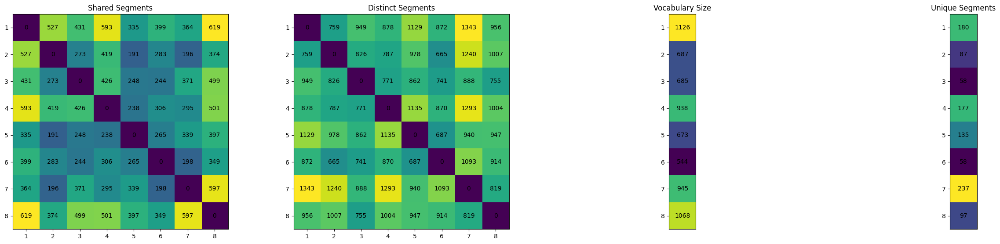

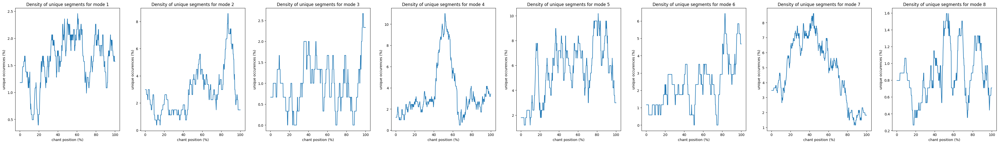

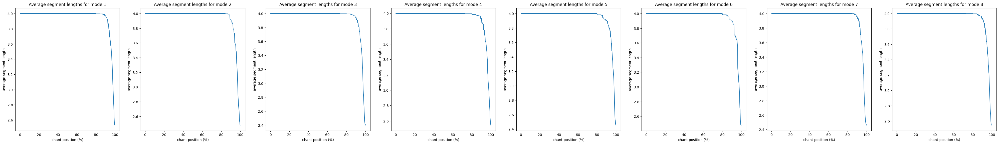

-------------------------------------------------------
----------------------------- Segments Occurences regarding the mode -----------------------------


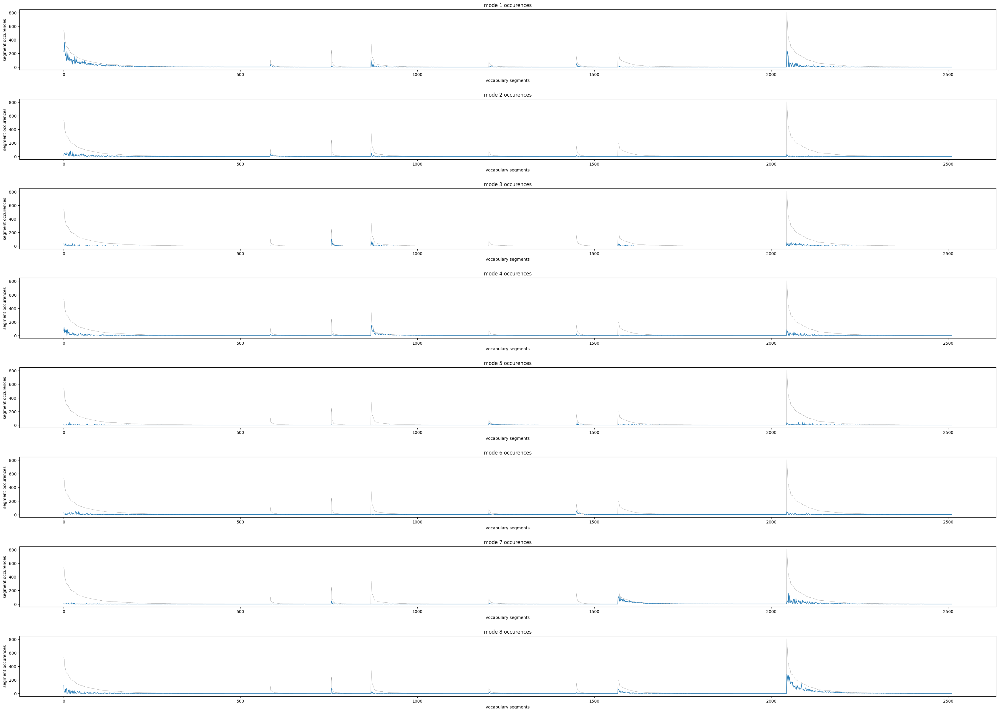

--------------------------------------------------------------------------------------------------
--------------------------------------------------------------------------




Top selected melodies - from model: ['ghgf', 'hgfg', 'gfgh', 'gfed', 'fghg', 'fedd', 'fghh', 'g', 'hghg', 'fgfe', 'gghg', 'gg', 'efgf', 'ghhg', 'kjhg', 'fefg', 'defg', 'gfgg', 'd', 'fedc', 'edcd', 'hgfe', 'fede', 'hggg', 'kkjh', 'ffed', 'ghgg', 'gggg', 'hhgf', 'dd', 'dcdf', 'hhgg', 'gggh', 'kkkk', 'efgg', 'ghgh', 'hhgh', 'fedf', 'hgff', 'fggh', 'ghkk', 'jhgh', 'jhgg', 'hgg', 'dcdd', 'efed', 'ggfg', 'gfef', 'hggf', 'hjhg', 'jklk', 'hghk', 'lmlk', 'fgff', 'kjkl', 'hkjh', 'ghhh', 'hggh', 'hhhg', 'hhhh', 'fggg', 'gfgf', 'hkhg', 'ddcd', 'ddcf', 'ghkh', 'ggkh', 'dfed', 'kjhk', 'edd', 'khgh', 'cdff', 'efgh', 'jkhg', 'fggf', 'klkk', 'fgfg', 'kkkj', 'ggfe', 'cdfe', 'gfff', 'klkj', 'gjkl', 'hghh', 'dcfg', 'gffe', 'fffe', 'hkkj', 'ffff', 'khgg', 'e', 'kklk', 'gggf', 'hgfh', 'edef', 'klkh', 'gfhk', 'kkjk', 'cddd', 'ghfe']


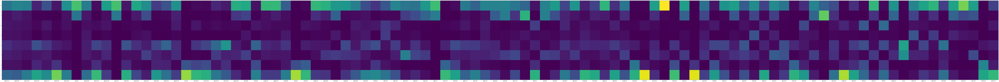

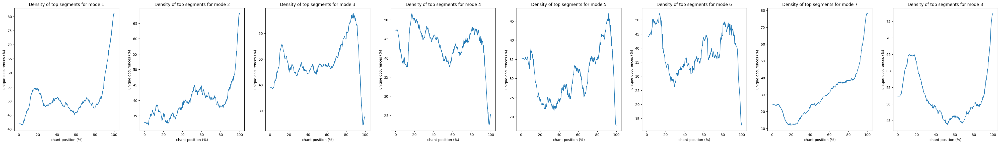





------------------------- Train + Test data charts ----------------------------
------------- Modes Vocabulary Statistics -------------


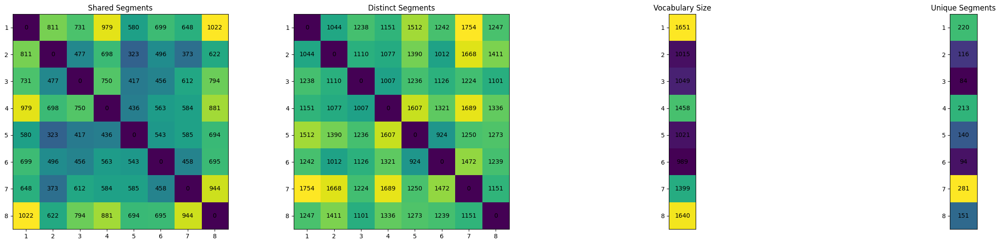

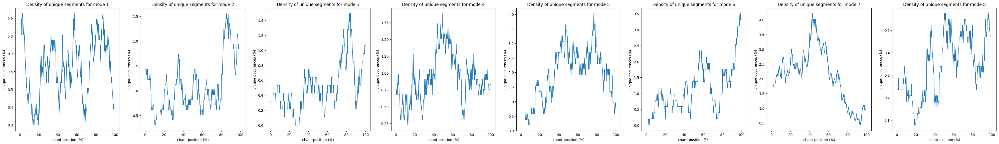

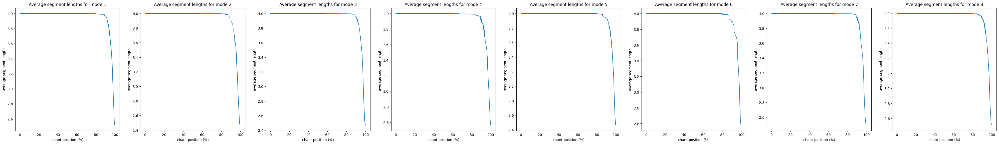

-------------------------------------------------------
------------------------------------------------------------------------


In [6]:
from src.utils.loader import prepare_dataset, load_ngram_segmentations
from src.eval.pipelines import evaluation_pipeline


# Get Data
_, y = prepare_dataset()
y_train, y_test = y[:9486].tolist(), y[9486:].tolist()
word_segmentations = load_ngram_segmentations(n=4)
train_segmentation, test_segmentation = word_segmentations[:9486], word_segmentations[9486:]
# Evaluate model
bacor_model = evaluation_pipeline(
    train_segmentation, y_train, test_segmentation, y_test,
    max_features_from_model = 100, include_additative = False, fe_occurence_coef=10)

INFO:root:Number of chants: 13551


/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:629: FutureWarning: The default value for `force_alpha` will change to `True` in 1.4. To suppress this warning, manually set the value of `force_alpha`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:635: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10. Use `force_alpha=True` to keep alpha unchanged.
  warnings.warn(
INFO:root:The SVC model was trained with 9486 training data and 9486 testing data.
INFO:root:From model approach - Selected features: 1000 (only 100 of them will be chosen)
INFO:root:From model approach Train data - First feature occurences: 1649 , Last feature occurences: 279
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:629: FutureWarning: The default value for `force_alpha` will change to `True` in 1.4. To suppress this warning, manually set the value of `force_alpha`.
  warnings.warn(
/usr/local/lib/python3.10/dist-package

------------------------------- Train Scores -------------------------------

		 bacor accuracy and f1
			 accuracy: 96.15%
			 f1: 96.11%

		 NB accuracy and f1
			 accuracy: 95.47%
			 f1: 95.53%

		 Perplexity
			 -1.000000

		 Vocabulary Size
			 size: 5683 unique segments

		 Average Segment Length
			 avgerage: 3.89 tones in one segment

		 Melody Justified With Words
			 words justification: 32.09% of segments
			 segments justification: 29.73% of segments
			 average justification: 30.91% of segments

		 Weighted Top Mode Frequency
			 wtmf: 54.33% of melodies

		 Weighted Unique Final Pitch Count
			 wufpc: 6.33 final pitches for a chant

		 Vocabulary Levenhstein Score
			 vls: 1.00 vocab diversity
------------- Modes Vocabulary Statistics -------------


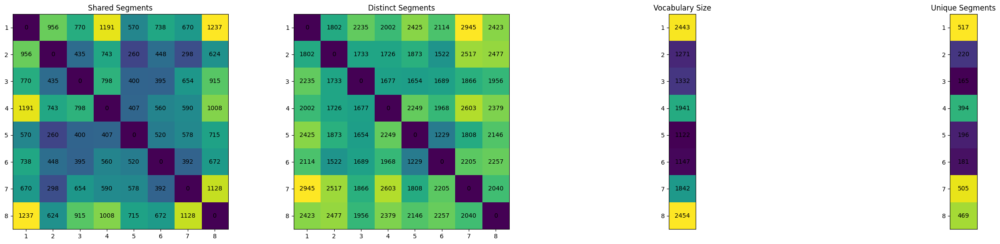

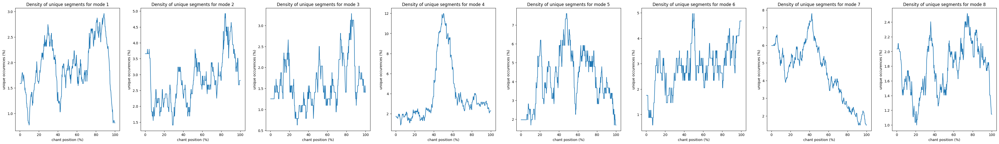

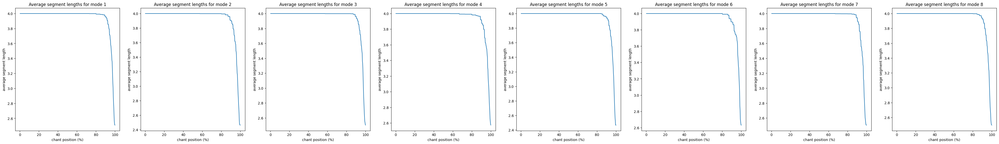

-------------------------------------------------------
----------------------------- Segments Occurences regarding the mode -----------------------------


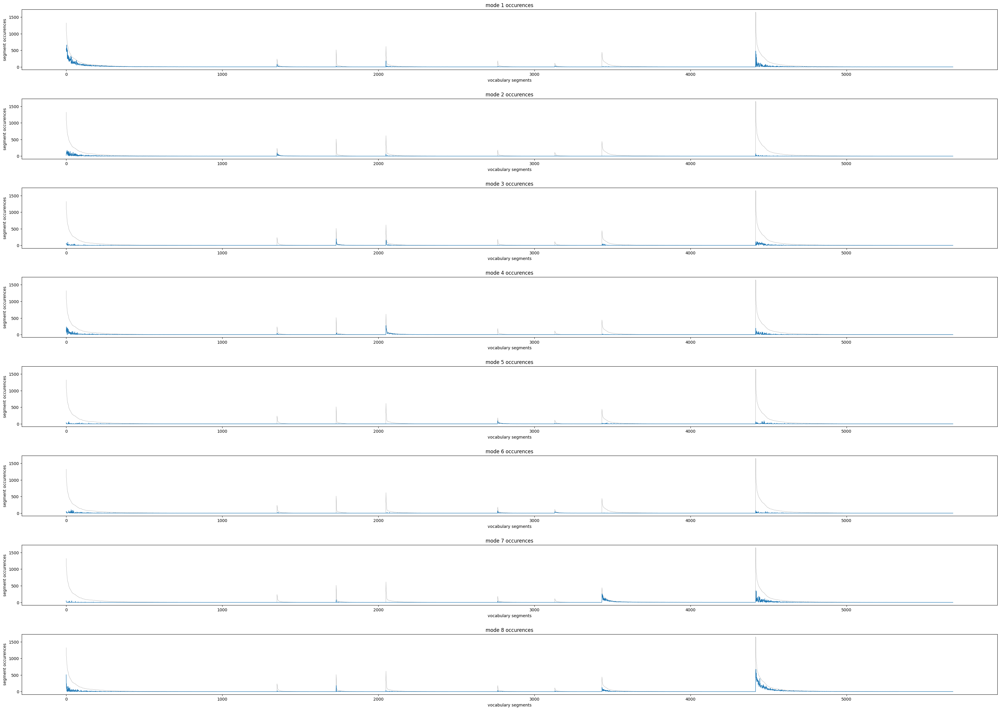

--------------------------------------------------------------------------------------------------
--------------------------------------------------------------------------






INFO:root:The SVC model was trained with 9486 training data and 4065 testing data.
INFO:root:From model approach - Selected features: 1000 (only 100 of them will be chosen)
INFO:root:From model approach Train data - First feature occurences: 1649 , Last feature occurences: 279
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:629: FutureWarning: The default value for `force_alpha` will change to `True` in 1.4. To suppress this warning, manually set the value of `force_alpha`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:635: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10. Use `force_alpha=True` to keep alpha unchanged.
  warnings.warn(
INFO:root:From model approach - reduced bacor accuracy: 90.23%, reduced bacor f1: 90.18% - reduced NB accuracy: 86.69%, reduced NB f1: 86.26%


------------------------------- Test Scores -------------------------------

		 bacor accuracy and f1
			 accuracy: 91.27%
			 f1: 91.14%

		 NB accuracy and f1
			 accuracy: 83.25%
			 f1: 83.62%

		 Perplexity
			 -1.000000

		 Vocabulary Size
			 size: 4211 unique segments

		 Average Segment Length
			 avgerage: 3.89 tones in one segment

		 Melody Justified With Phrases
			 mjww: -100.00% of segments

		 Melody Justified With Words
			 words justification: 31.62% of segments
			 segments justification: 29.51% of segments
			 average justification: 30.56% of segments

		 Weighted Top Mode Frequency
			 wtmf: 55.05% of melodies

		 Weighted Unique Final Pitch Count
			 wufpc: 6.36 final pitches for a chant

		 Vocabulary Levenhstein Score
			 vls: 1.00 vocab diversity
------------- Modes Vocabulary Statistics -------------


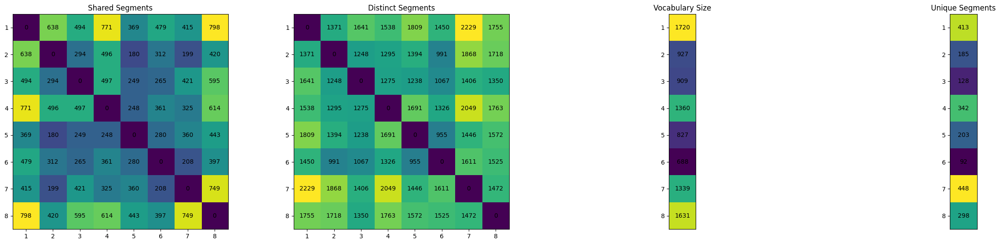

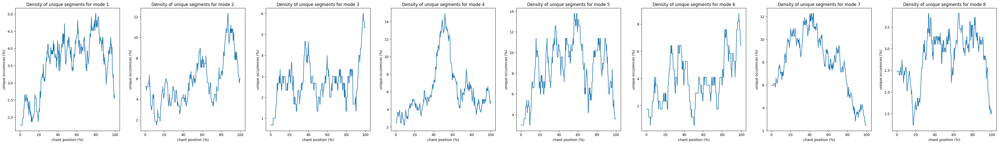

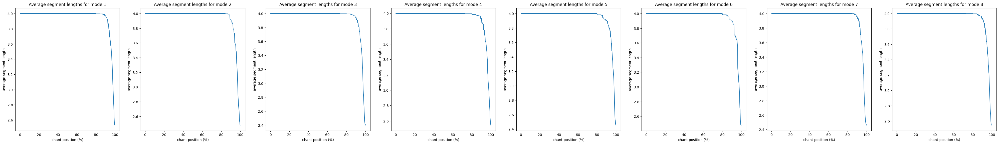

-------------------------------------------------------
----------------------------- Segments Occurences regarding the mode -----------------------------


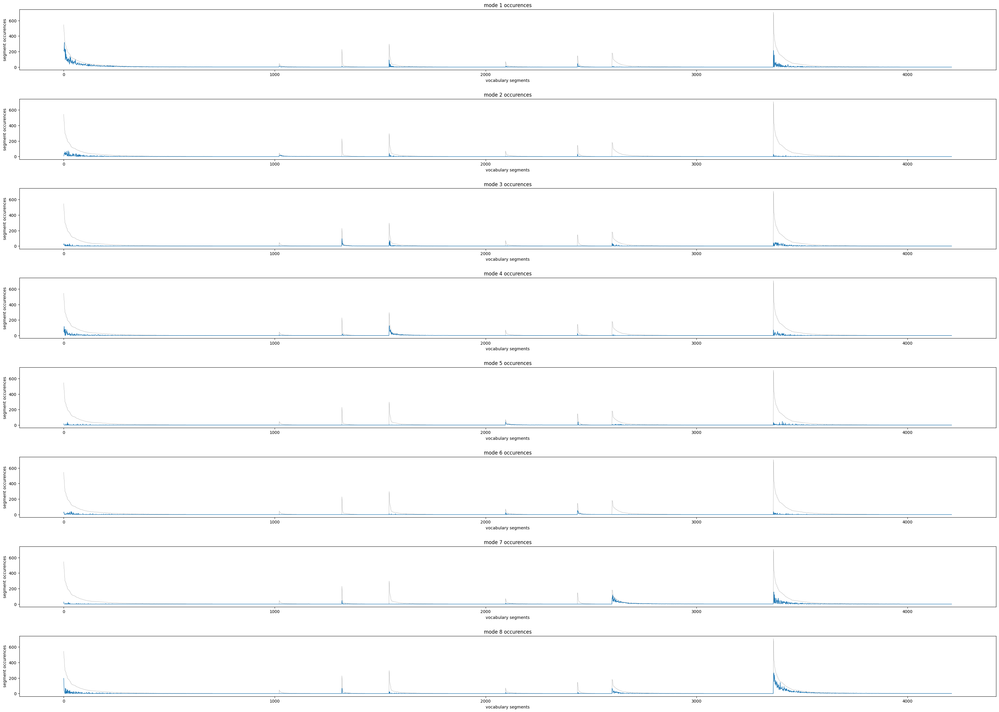

--------------------------------------------------------------------------------------------------
--------------------------------------------------------------------------




Top selected melodies - from model: ['ghgf', 'hgfg', 'gfgh', 'gfed', 'fghg', 'g', 'fghh', 'fedd', 'gg', 'hghg', 'fgfe', 'efgf', 'gghg', 'ghhg', 'd', 'defg', 'kjhg', 'gfgg', 'gggg', 'dd', 'fefg', 'hgfe', 'fede', 'kkjh', 'edcd', 'hggg', 'kkkk', 'fedc', 'gggh', 'hhgf', 'ffed', 'ghgg', 'dcdf', 'ghgh', 'hhgg', 'ghkk', 'fggh', 'hhgh', 'efgg', 'hgg', 'hgff', 'fedf', 'jhgh', 'hghk', 'dcdd', 'hhhh', 'jhgg', 'jklk', 'lmlk', 'ghhh', 'efed', 'ggkh', 'kjkl', 'fggg', 'ghkh', 'gfef', 'hhhg', 'ddcd', 'efgh', 'cdff', 'khgh', 'fgff', 'gfgf', 'hkjh', 'edd', 'hggh', 'kjhk', 'fgfg', 'gjkl', 'dfed', 'e', 'hggf', 'kkkj', 'klkk', 'ffff', 'ddcf', 'fggf', 'gfff', 'klkj', 'hghh', 'hkkj', 'kklk', 'ggfe', 'cdfe', 'gghk', 'fffe', 'kkjk', 'hkkk', 'ee', 'gfhk', 'edef', 'klkh', 'klml', 'hgfh', 'khgg', 'fghf', 'ghfe', 'fhkk', 'gggf', 'dcfg']


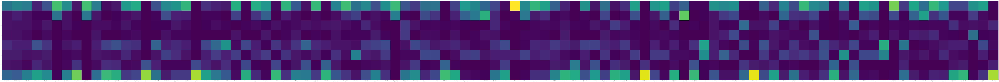

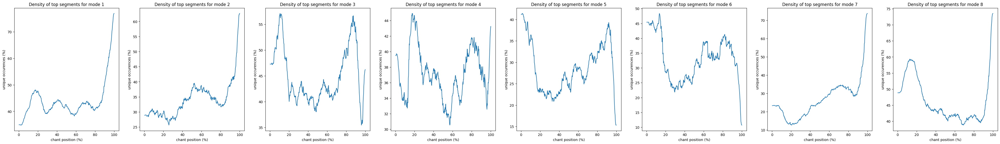





------------------------- Train + Test data charts ----------------------------
------------- Modes Vocabulary Statistics -------------


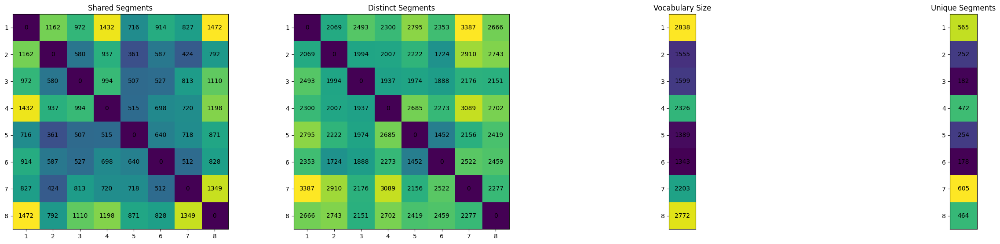

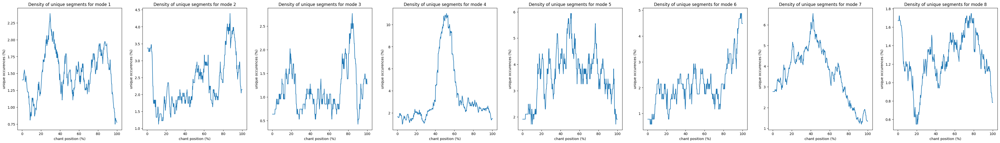

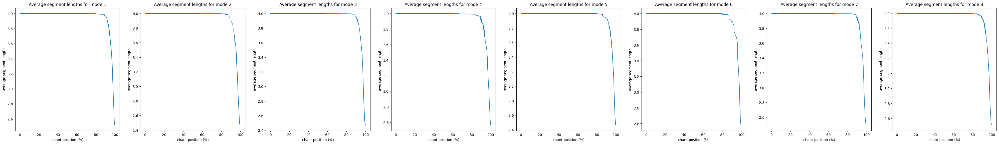

-------------------------------------------------------
------------------------------------------------------------------------


In [7]:
from src.utils.loader import prepare_dataset, load_ngram_segmentations
from src.eval.pipelines import evaluation_pipeline


# Get Data
_, y = prepare_dataset()
y_train, y_test = y[:9486].tolist(), y[9486:].tolist()
word_segmentations = load_ngram_segmentations(n=4, liquescents=True)
train_segmentation, test_segmentation = word_segmentations[:9486], word_segmentations[9486:]
# Evaluate model
bacor_model = evaluation_pipeline(
    train_segmentation, y_train, test_segmentation, y_test,
    max_features_from_model = 100, include_additative = False, fe_occurence_coef=10)

### 5-gram

INFO:root:Number of chants: 13551


/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:629: FutureWarning: The default value for `force_alpha` will change to `True` in 1.4. To suppress this warning, manually set the value of `force_alpha`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:635: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10. Use `force_alpha=True` to keep alpha unchanged.
  warnings.warn(
INFO:root:The SVC model was trained with 9486 training data and 9486 testing data.
INFO:root:From model approach - Selected features: 1000 (only 100 of them will be chosen)
INFO:root:From model approach Train data - First feature occurences: 794 , Last feature occurences: 153
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:629: FutureWarning: The default value for `force_alpha` will change to `True` in 1.4. To suppress this warning, manually set the value of `force_alpha`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages

------------------------------- Train Scores -------------------------------

		 bacor accuracy and f1
			 accuracy: 97.74%
			 f1: 97.72%

		 NB accuracy and f1
			 accuracy: 96.59%
			 f1: 96.63%

		 Perplexity
			 -1.000000

		 Vocabulary Size
			 size: 8210 unique segments

		 Average Segment Length
			 avgerage: 4.82 tones in one segment

		 Melody Justified With Words
			 words justification: 33.26% of segments
			 segments justification: 24.87% of segments
			 average justification: 29.07% of segments

		 Weighted Top Mode Frequency
			 wtmf: 59.50% of melodies

		 Weighted Unique Final Pitch Count
			 wufpc: 5.52 final pitches for a chant

		 Vocabulary Levenhstein Score
			 vls: 0.95 vocab diversity
------------- Modes Vocabulary Statistics -------------


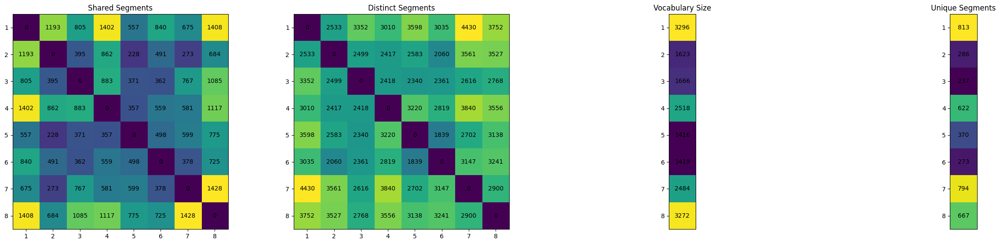

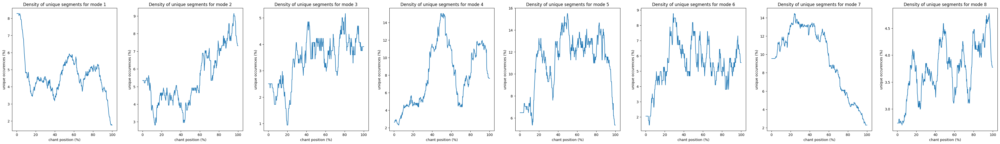

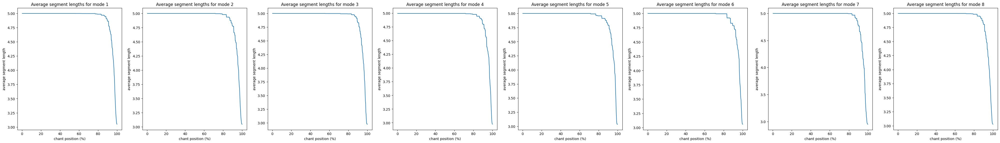

-------------------------------------------------------
----------------------------- Segments Occurences regarding the mode -----------------------------


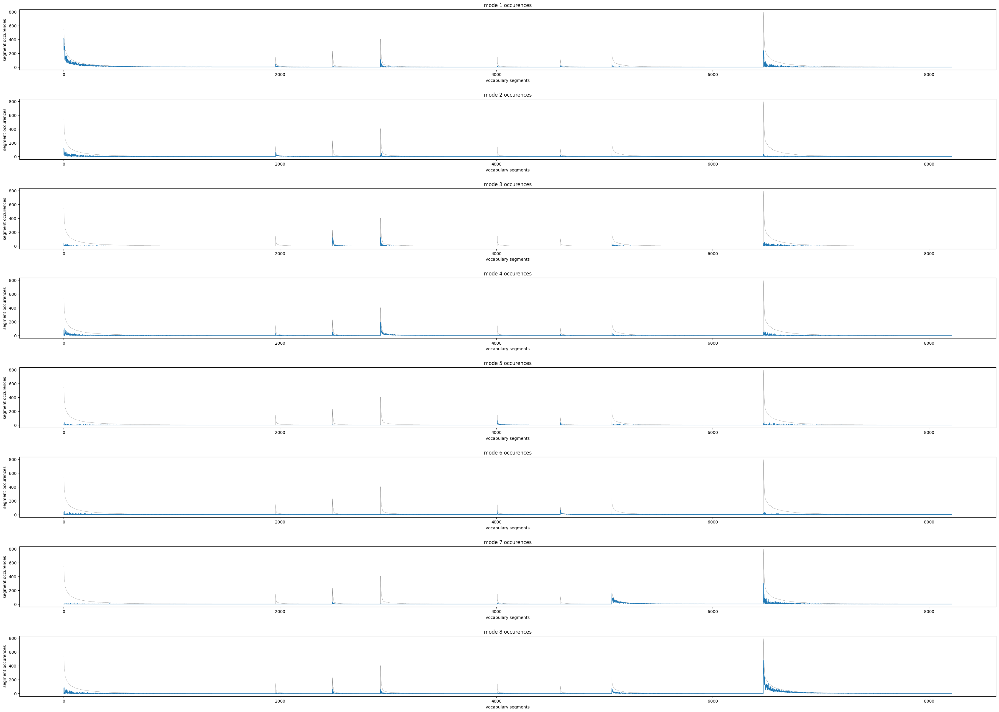

--------------------------------------------------------------------------------------------------
--------------------------------------------------------------------------






INFO:root:The SVC model was trained with 9486 training data and 4065 testing data.
INFO:root:From model approach - Selected features: 1000 (only 100 of them will be chosen)
INFO:root:From model approach Train data - First feature occurences: 794 , Last feature occurences: 153
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:629: FutureWarning: The default value for `force_alpha` will change to `True` in 1.4. To suppress this warning, manually set the value of `force_alpha`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:635: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10. Use `force_alpha=True` to keep alpha unchanged.
  warnings.warn(
INFO:root:From model approach - reduced bacor accuracy: 89.00%, reduced bacor f1: 88.92% - reduced NB accuracy: 85.68%, reduced NB f1: 85.19%


------------------------------- Test Scores -------------------------------

		 bacor accuracy and f1
			 accuracy: 91.69%
			 f1: 91.57%

		 NB accuracy and f1
			 accuracy: 85.41%
			 f1: 85.75%

		 Perplexity
			 -1.000000

		 Vocabulary Size
			 size: 6029 unique segments

		 Average Segment Length
			 avgerage: 4.82 tones in one segment

		 Melody Justified With Phrases
			 mjww: -100.00% of segments

		 Melody Justified With Words
			 words justification: 33.14% of segments
			 segments justification: 24.96% of segments
			 average justification: 29.05% of segments

		 Weighted Top Mode Frequency
			 wtmf: 61.33% of melodies

		 Weighted Unique Final Pitch Count
			 wufpc: 5.58 final pitches for a chant

		 Vocabulary Levenhstein Score
			 vls: 0.94 vocab diversity
------------- Modes Vocabulary Statistics -------------


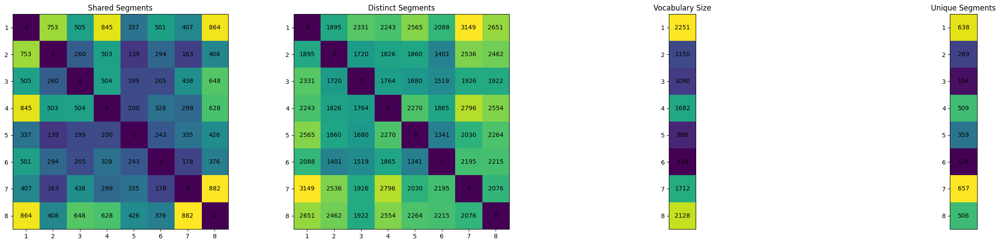

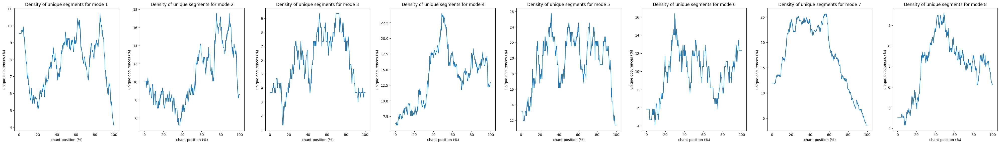

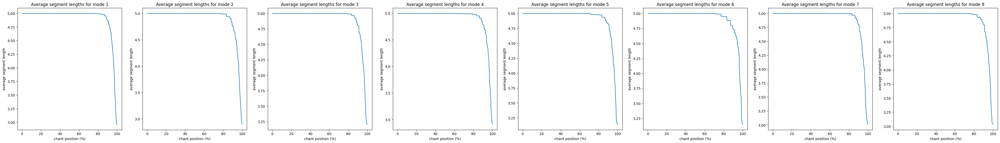

-------------------------------------------------------
----------------------------- Segments Occurences regarding the mode -----------------------------


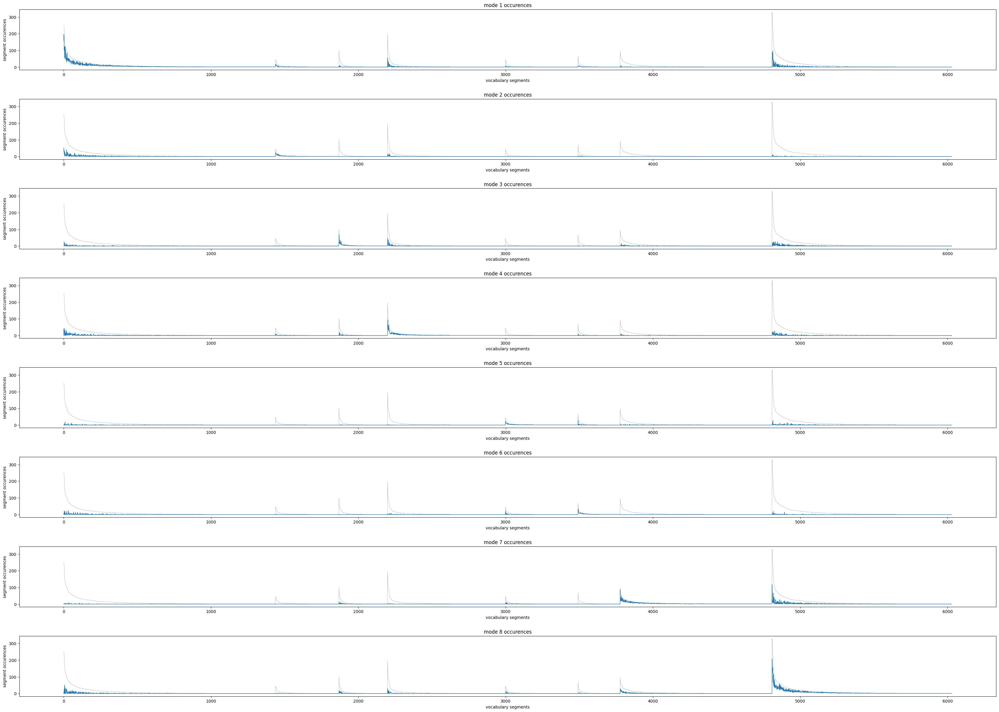

--------------------------------------------------------------------------------------------------
--------------------------------------------------------------------------




Top selected melodies - from model: ['g', 'gg', 'ghgfg', 'hgfgh', 'd', 'fgfed', 'fghgf', 'dd', 'fghhg', 'gfghh', 'gfghg', 'hghgf', 'efgfe', 'ghgfe', 'hgg', 'gghgf', 'fedcd', 'hgfgg', 'gfedd', 'fedd', 'ddcfg', 'edd', 'e', 'ghgff', 'ghhgg', 'hhgfg', 'fefgf', 'fghhh', 'hkjhg', 'hgfed', 'ggkhg', 'kkjhg', 'defgg', 'ggghg', 'ggfgh', 'gfede', 'ghfed', 'gfefg', 'hgfgf', 'ggjkl', 'fgghg', 'edcdd', 'ghkkk', 'gfedc', 'dcdfe', 'kkkkk', 'ee', 'ddcdf', 'fghgh', 'efggg', 'ghghg', 'kjklk', 'hjhgg', 'fghgg', 'ljlml', 'fedef', 'hgfef', 'feddd', 'kkkjh', 'gfedf', 'fedee', 'efedd', 'ghhgf', 'kjhgg', 'dcdff', 'ghggg', 'dddcf', 'ggggh', 'jklkh', 'kkjhk', 'hhhgh', 'hggfg', 'hgggg', 'hgefg', 'khghg', 'ghjhg', 'gghgg', 'fgfgh', 'ggggg', 'ghkhg', 'ffede', 'hhghg', 'kkjkl', 'cdfed', 'dcdef', 'hgghg', 'hhgg', 'ffedc', 'dcfgh', 'ghggf', 'd

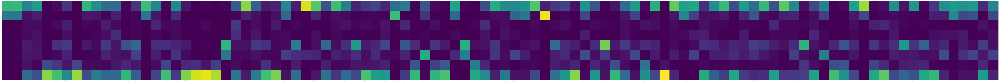

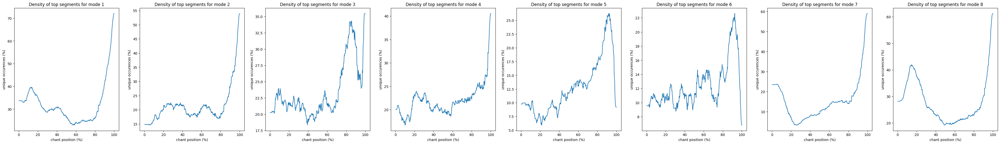





------------------------- Train + Test data charts ----------------------------
------------- Modes Vocabulary Statistics -------------


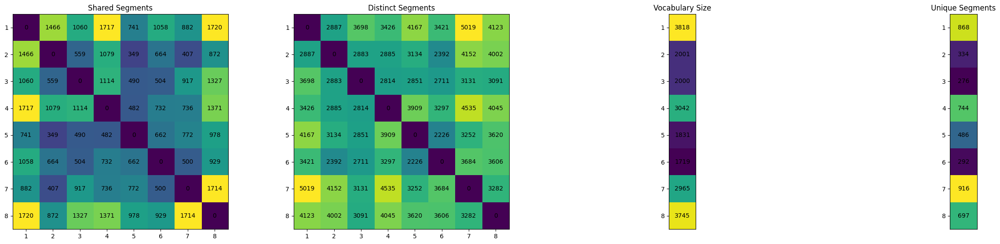

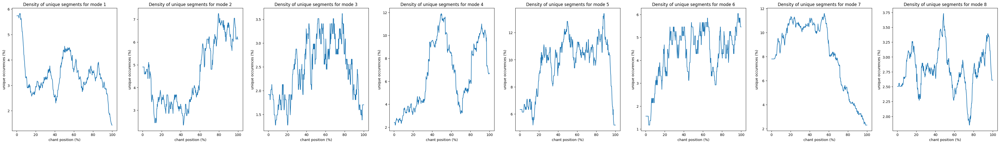

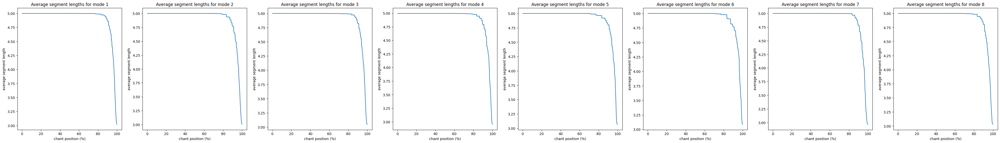

-------------------------------------------------------
------------------------------------------------------------------------


In [8]:
from src.utils.loader import prepare_dataset, load_ngram_segmentations
from src.eval.pipelines import evaluation_pipeline


# Get Data
_, y = prepare_dataset()
y_train, y_test = y[:9486].tolist(), y[9486:].tolist()
word_segmentations = load_ngram_segmentations(n=5)
train_segmentation, test_segmentation = word_segmentations[:9486], word_segmentations[9486:]
# Evaluate model
bacor_model = evaluation_pipeline(
    train_segmentation, y_train, test_segmentation, y_test,
    max_features_from_model = 100, include_additative = False, fe_occurence_coef=10)

INFO:root:Number of chants: 13551


/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:629: FutureWarning: The default value for `force_alpha` will change to `True` in 1.4. To suppress this warning, manually set the value of `force_alpha`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:635: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10. Use `force_alpha=True` to keep alpha unchanged.
  warnings.warn(
INFO:root:The SVC model was trained with 9486 training data and 9486 testing data.
INFO:root:From model approach - Selected features: 1000 (only 100 of them will be chosen)
INFO:root:From model approach Train data - First feature occurences: 794 , Last feature occurences: 127
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:629: FutureWarning: The default value for `force_alpha` will change to `True` in 1.4. To suppress this warning, manually set the value of `force_alpha`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages

------------------------------- Train Scores -------------------------------

		 bacor accuracy and f1
			 accuracy: 98.18%
			 f1: 98.16%

		 NB accuracy and f1
			 accuracy: 96.56%
			 f1: 96.60%

		 Perplexity
			 -1.000000

		 Vocabulary Size
			 size: 13260 unique segments

		 Average Segment Length
			 avgerage: 4.82 tones in one segment

		 Melody Justified With Words
			 words justification: 33.26% of segments
			 segments justification: 24.87% of segments
			 average justification: 29.07% of segments

		 Weighted Top Mode Frequency
			 wtmf: 62.12% of melodies

		 Weighted Unique Final Pitch Count
			 wufpc: 5.90 final pitches for a chant

		 Vocabulary Levenhstein Score
			 vls: 0.98 vocab diversity
------------- Modes Vocabulary Statistics -------------


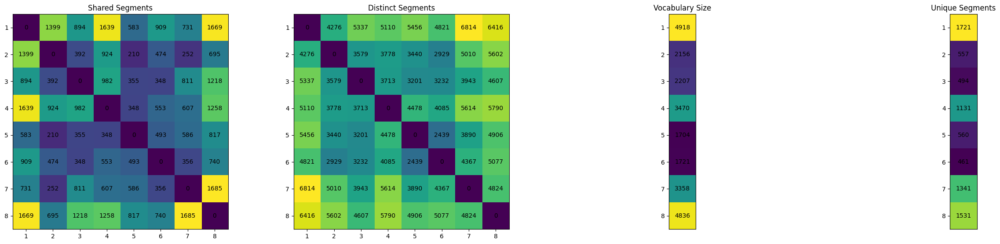

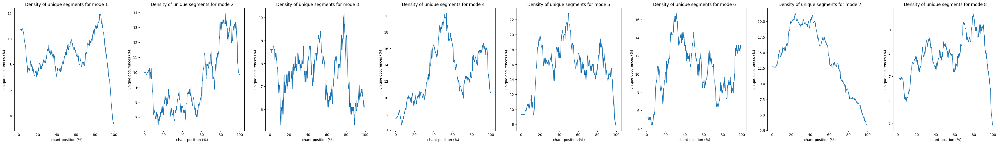

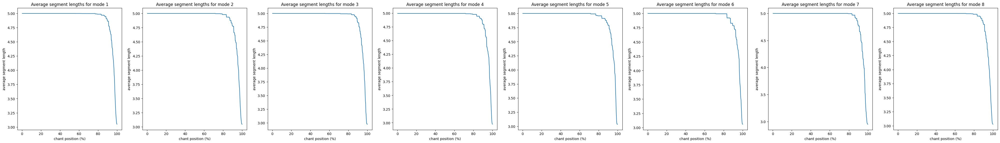

-------------------------------------------------------
----------------------------- Segments Occurences regarding the mode -----------------------------


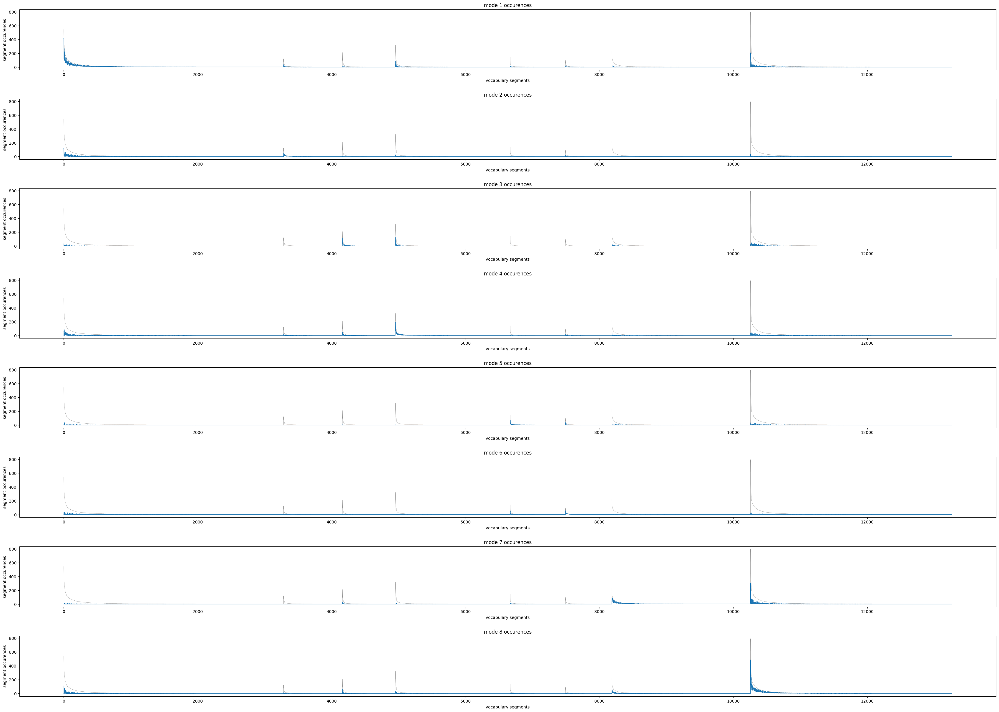

--------------------------------------------------------------------------------------------------
--------------------------------------------------------------------------






INFO:root:The SVC model was trained with 9486 training data and 4065 testing data.
INFO:root:From model approach - Selected features: 1000 (only 100 of them will be chosen)
INFO:root:From model approach Train data - First feature occurences: 794 , Last feature occurences: 127
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:629: FutureWarning: The default value for `force_alpha` will change to `True` in 1.4. To suppress this warning, manually set the value of `force_alpha`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:635: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10. Use `force_alpha=True` to keep alpha unchanged.
  warnings.warn(
INFO:root:From model approach - reduced bacor accuracy: 87.36%, reduced bacor f1: 87.28% - reduced NB accuracy: 85.12%, reduced NB f1: 84.63%


------------------------------- Test Scores -------------------------------

		 bacor accuracy and f1
			 accuracy: 90.06%
			 f1: 89.90%

		 NB accuracy and f1
			 accuracy: 83.76%
			 f1: 84.23%

		 Perplexity
			 -1.000000

		 Vocabulary Size
			 size: 8849 unique segments

		 Average Segment Length
			 avgerage: 4.82 tones in one segment

		 Melody Justified With Phrases
			 mjww: -100.00% of segments

		 Melody Justified With Words
			 words justification: 33.14% of segments
			 segments justification: 24.96% of segments
			 average justification: 29.05% of segments

		 Weighted Top Mode Frequency
			 wtmf: 64.58% of melodies

		 Weighted Unique Final Pitch Count
			 wufpc: 5.93 final pitches for a chant

		 Vocabulary Levenhstein Score
			 vls: 0.96 vocab diversity
------------- Modes Vocabulary Statistics -------------


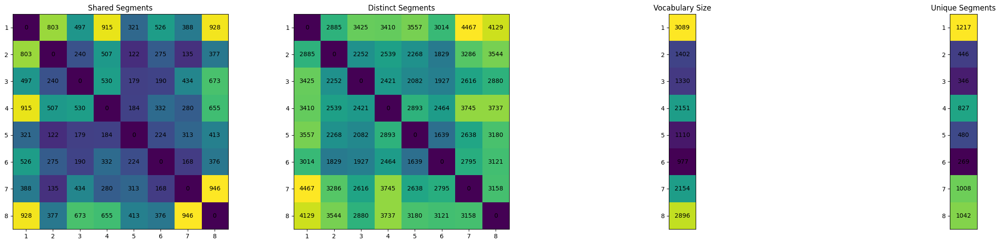

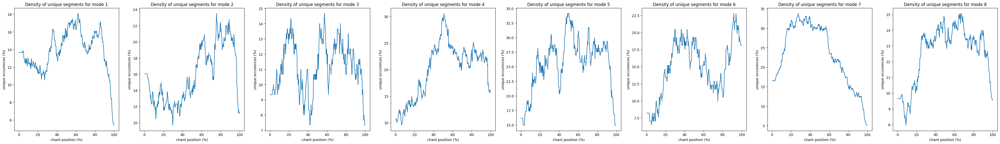

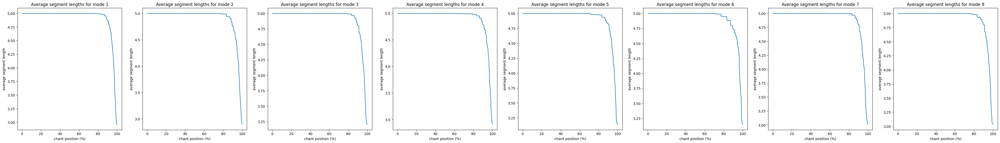

-------------------------------------------------------
----------------------------- Segments Occurences regarding the mode -----------------------------


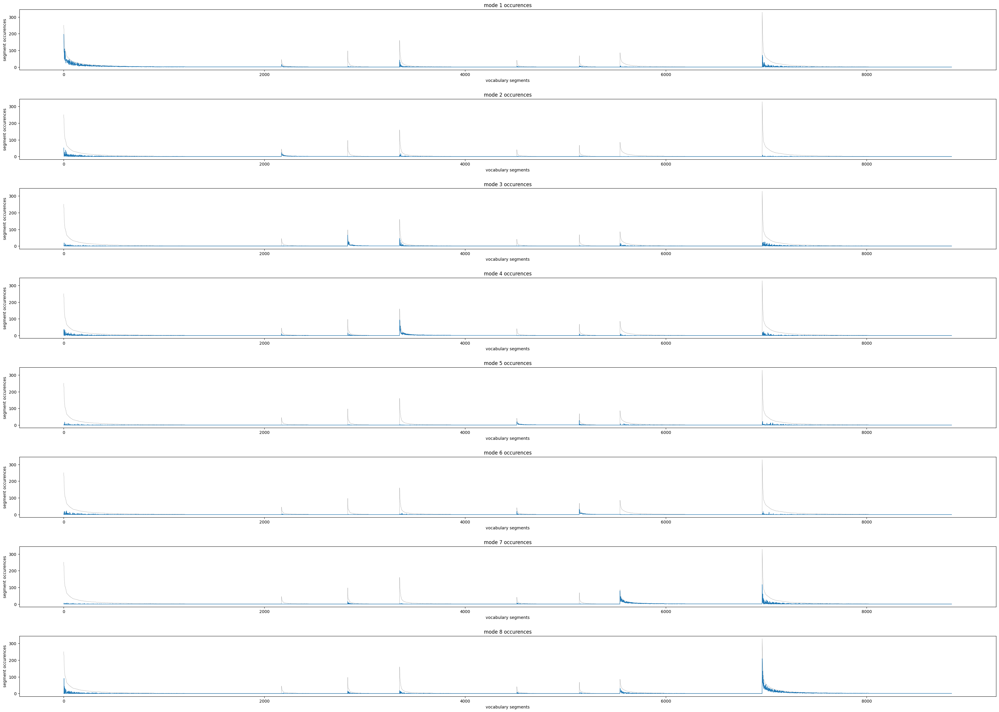

--------------------------------------------------------------------------------------------------
--------------------------------------------------------------------------




Top selected melodies - from model: ['g', 'gg', 'ghgfg', 'hgfgh', 'd', 'dd', 'fgfed', 'fghgf', 'fghhg', 'gfghh', 'hgg', 'gfghg', 'hghgf', 'efgfe', 'gghgf', 'e', 'ghgfe', 'fedd', 'fedcd', 'gfedd', 'edd', 'ghhgg', 'ghgff', 'kjhgh', 'ggkhg', 'fefgf', 'fghhh', 'hhgfg', 'ddcfg', 'defgg', 'hgfed', 'ggghg', 'ggjkl', 'kkkkk', 'ghfed', 'ee', 'gfefg', 'ghkkk', 'gfede', 'hgfgf', 'kkjhg', 'gfedc', 'ddcdf', 'hkjhg', 'hjhgg', 'gfggh', 'fghgh', 'edcdd', 'kjklk', 'ggfgh', 'ghghg', 'ljlml', 'fgghg', 'feddd', 'dcdfe', 'efggg', 'ggggh', 'fghgg', 'fedef', 'dcdff', 'kkkjh', 'gfedf', 'hgefg', 'dcdef', 'fedee', 'hgggg', 'fgfgh', 'ggggg', 'hgfef', 'ghhgf', 'ghggg', 'efedd', 'kkjhk', 'jklkh', 'kkjkl', 'ghjhg', 'khghg', 'ghkhg', 'defgh', 'hhhgh', 'hhgg', 'ggkhh', 'hhhhh', 'gghgg', 'efghg', 'f', 'jkhgh', 'defgf', 'kjhgg', 'lkjkl', 'klkjh

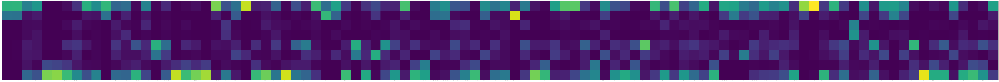

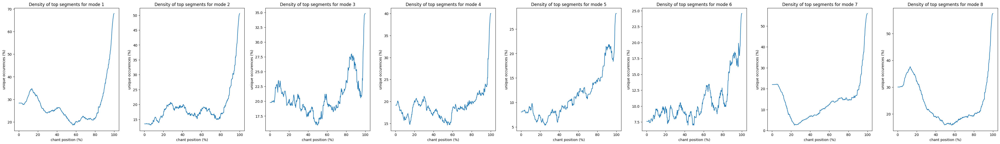





------------------------- Train + Test data charts ----------------------------
------------- Modes Vocabulary Statistics -------------


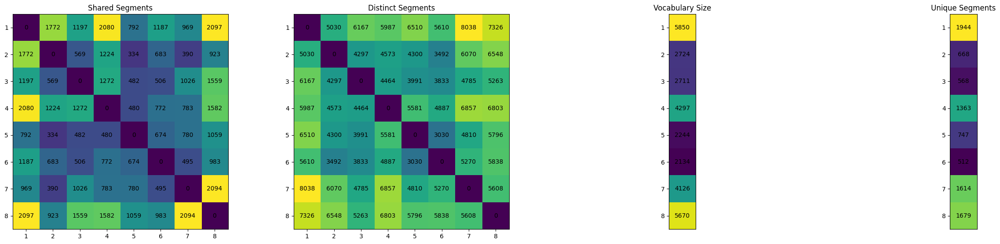

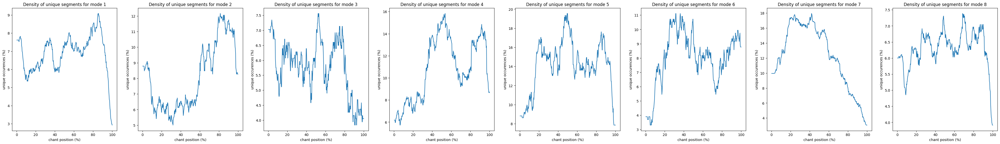

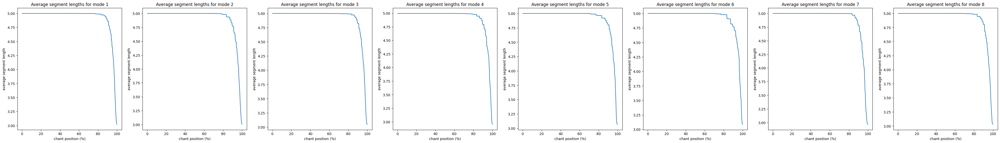

-------------------------------------------------------
------------------------------------------------------------------------


In [9]:
from src.utils.loader import prepare_dataset, load_ngram_segmentations
from src.eval.pipelines import evaluation_pipeline


# Get Data
_, y = prepare_dataset()
y_train, y_test = y[:9486].tolist(), y[9486:].tolist()
word_segmentations = load_ngram_segmentations(n=5, liquescents=True)
train_segmentation, test_segmentation = word_segmentations[:9486], word_segmentations[9486:]
# Evaluate model
bacor_model = evaluation_pipeline(
    train_segmentation, y_train, test_segmentation, y_test,
    max_features_from_model = 100, include_additative = False, fe_occurence_coef=10)

### 6-gram

INFO:root:Number of chants: 13551


/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:629: FutureWarning: The default value for `force_alpha` will change to `True` in 1.4. To suppress this warning, manually set the value of `force_alpha`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:635: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10. Use `force_alpha=True` to keep alpha unchanged.
  warnings.warn(
INFO:root:The SVC model was trained with 9486 training data and 9486 testing data.
INFO:root:From model approach - Selected features: 1000 (only 100 of them will be chosen)
INFO:root:From model approach Train data - First feature occurences: 704 , Last feature occurences: 72
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:629: FutureWarning: The default value for `force_alpha` will change to `True` in 1.4. To suppress this warning, manually set the value of `force_alpha`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/

------------------------------- Train Scores -------------------------------

		 bacor accuracy and f1
			 accuracy: 98.41%
			 f1: 98.40%

		 NB accuracy and f1
			 accuracy: 96.80%
			 f1: 96.82%

		 Perplexity
			 -1.000000

		 Vocabulary Size
			 size: 16485 unique segments

		 Average Segment Length
			 avgerage: 5.73 tones in one segment

		 Melody Justified With Words
			 words justification: 34.90% of segments
			 segments justification: 21.96% of segments
			 average justification: 28.43% of segments

		 Weighted Top Mode Frequency
			 wtmf: 68.22% of melodies

		 Weighted Unique Final Pitch Count
			 wufpc: 5.21 final pitches for a chant

		 Vocabulary Levenhstein Score
			 vls: 0.90 vocab diversity
------------- Modes Vocabulary Statistics -------------


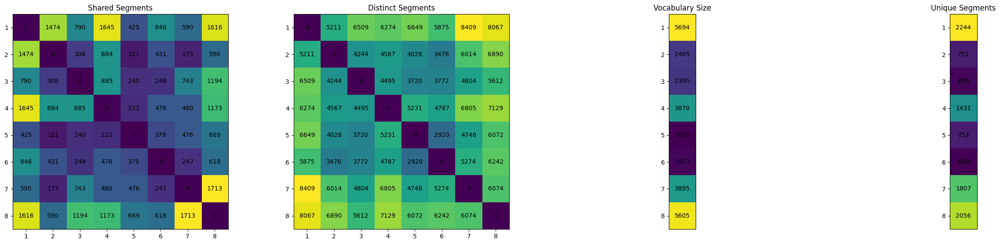

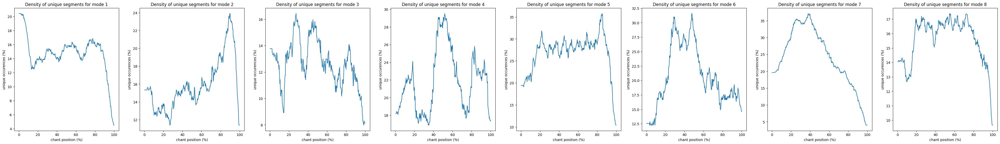

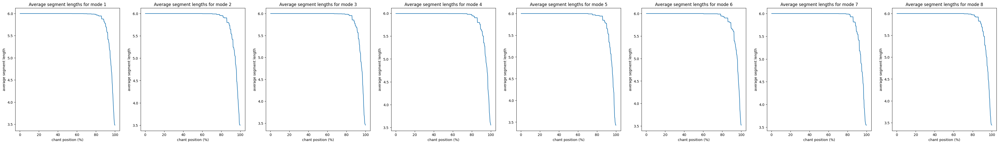

-------------------------------------------------------
----------------------------- Segments Occurences regarding the mode -----------------------------


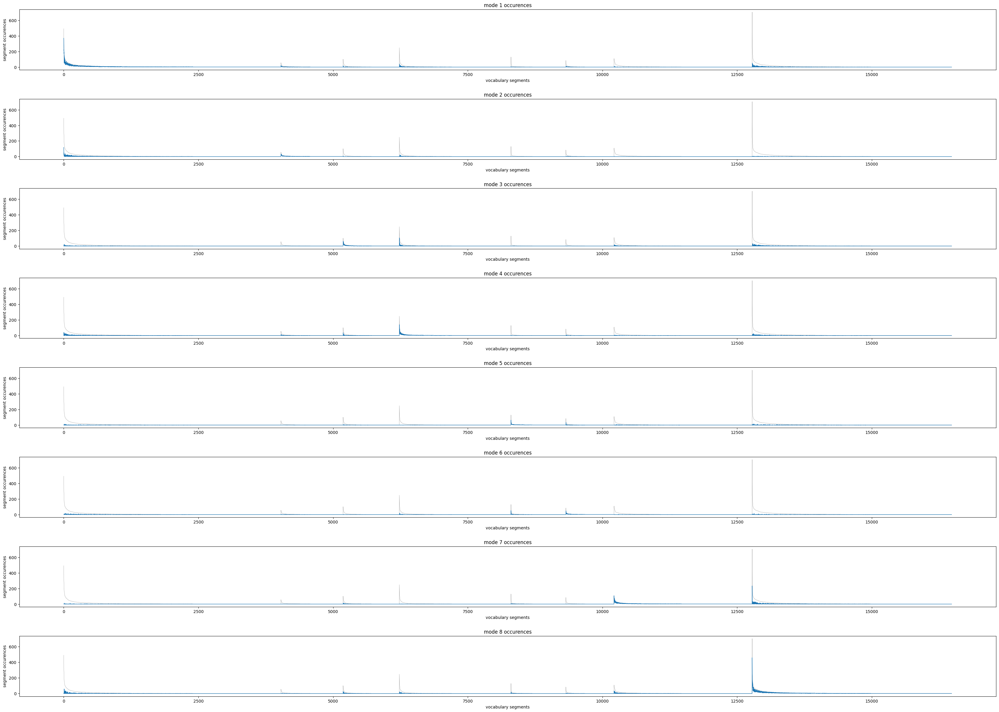

--------------------------------------------------------------------------------------------------
--------------------------------------------------------------------------






INFO:root:The SVC model was trained with 9486 training data and 4065 testing data.
INFO:root:From model approach - Selected features: 1000 (only 100 of them will be chosen)
INFO:root:From model approach Train data - First feature occurences: 704 , Last feature occurences: 72
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:629: FutureWarning: The default value for `force_alpha` will change to `True` in 1.4. To suppress this warning, manually set the value of `force_alpha`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:635: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10. Use `force_alpha=True` to keep alpha unchanged.
  warnings.warn(
INFO:root:From model approach - reduced bacor accuracy: 83.49%, reduced bacor f1: 83.23% - reduced NB accuracy: 82.14%, reduced NB f1: 81.56%


------------------------------- Test Scores -------------------------------

		 bacor accuracy and f1
			 accuracy: 89.23%
			 f1: 89.05%

		 NB accuracy and f1
			 accuracy: 84.87%
			 f1: 85.30%

		 Perplexity
			 -1.000000

		 Vocabulary Size
			 size: 10938 unique segments

		 Average Segment Length
			 avgerage: 5.74 tones in one segment

		 Melody Justified With Phrases
			 mjww: -100.00% of segments

		 Melody Justified With Words
			 words justification: 34.87% of segments
			 segments justification: 22.07% of segments
			 average justification: 28.47% of segments

		 Weighted Top Mode Frequency
			 wtmf: 71.06% of melodies

		 Weighted Unique Final Pitch Count
			 wufpc: 5.24 final pitches for a chant

		 Vocabulary Levenhstein Score
			 vls: 0.90 vocab diversity
------------- Modes Vocabulary Statistics -------------


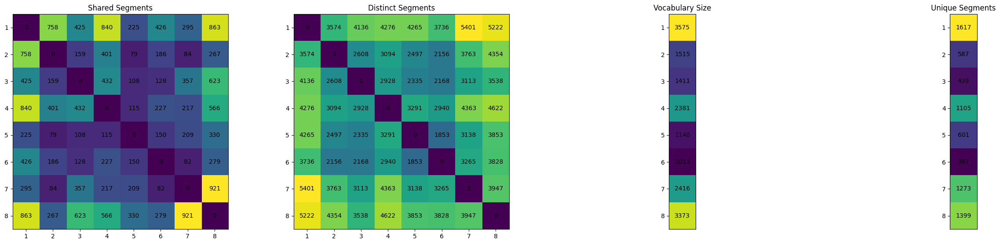

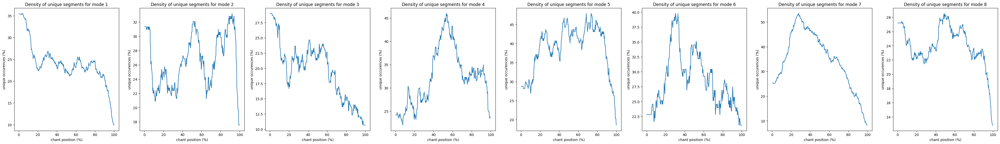

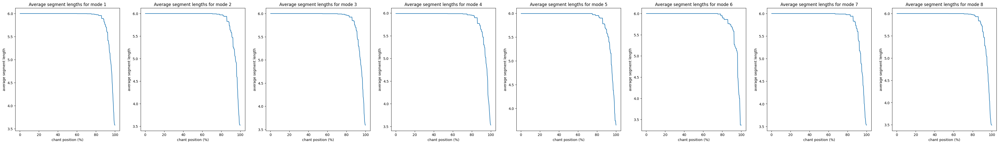

-------------------------------------------------------
----------------------------- Segments Occurences regarding the mode -----------------------------


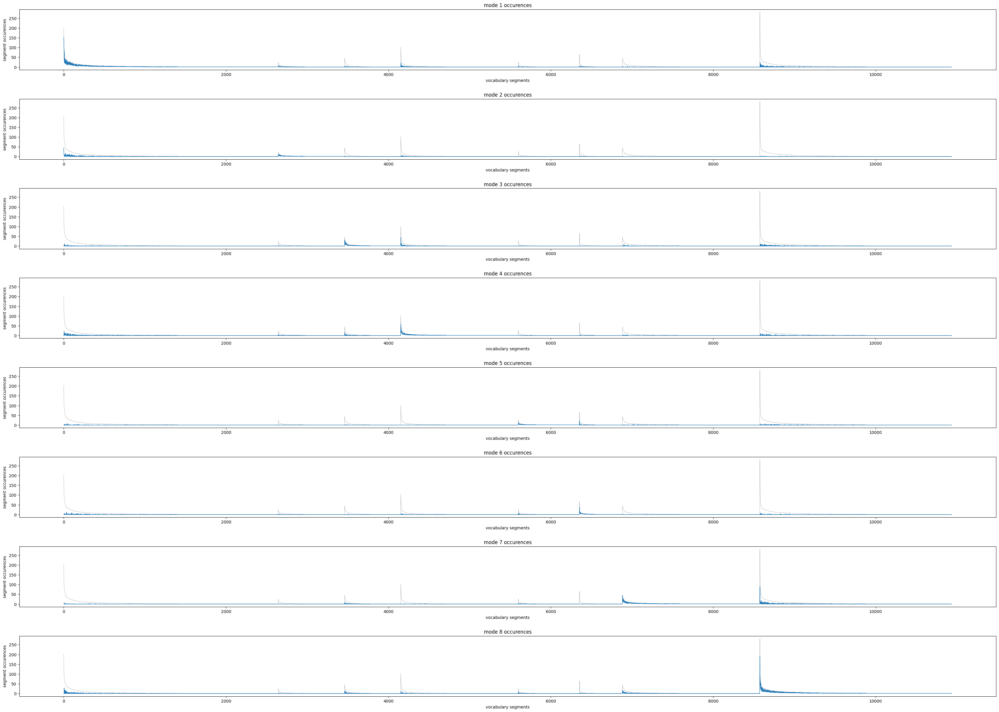

--------------------------------------------------------------------------------------------------
--------------------------------------------------------------------------




Top selected melodies - from model: ['g', 'gg', 'd', 'dd', 'hgg', 'edd', 'efgfed', 'fedd', 'ghgfgh', 'e', 'hgfghh', 'fghhgg', 'gfghhg', 'ee', 'fgfedd', 'ddcfgf', 'ghgfgg', 'fghgfg', 'fefgfe', 'ggkhgh', 'gfghgf', 'dddcfg', 'hhgg', 'ghgfed', 'kkjhgh', 'hgfefg', 'fedcdd', 'fghgfe', 'gghgfg', 'hgfghg', 'dcdfed', 'ghgfgf', 'f', 'ggkhhg', 'fedefg', 'gfedd', 'fghfed', 'hgfggh', 'gfedcd', 'ggghgf', 'ljlmll', 'hhgfgh', 'gfefgf', 'fghhhg', 'fgfedc', 'ddcdfe', 'gfedee', 'efghhg', 'hkjhgg', 'ggg', 'ghkkkk', 'hgfede', 'ddcfgh', 'kjhghg', 'fee', 'fghghg', 'fgghgf', 'hgghgf', 'ghhgg', 'jhgg', 'fedcdf', 'hggfgh', 'ffedcd', 'gfee', 'ghgefg', 'ggkjkl', 'fghhgf', 'kkkkkk', 'ggfghg', 'ghghgf', 'hgfgff', 'defggg', 'hkjhgh', 'gfghhh', 'hghgff', 'ff', 'fghgff', 'ggkhgf', 'gggghg', 'ghfedd', 'hhgfgg', 'gfgghg', 'dcdefg', 'gjklml', 'll

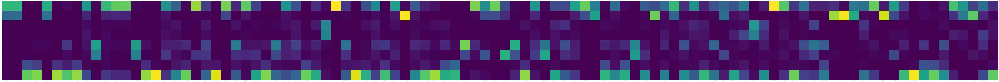

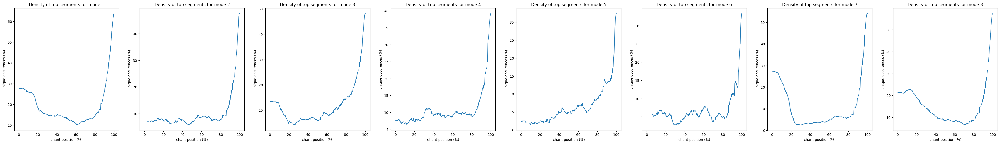





------------------------- Train + Test data charts ----------------------------
------------- Modes Vocabulary Statistics -------------


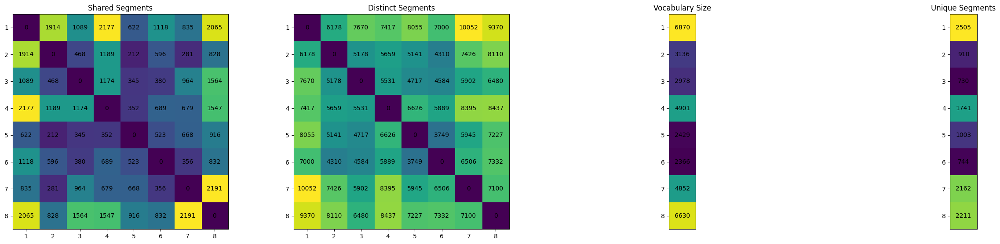

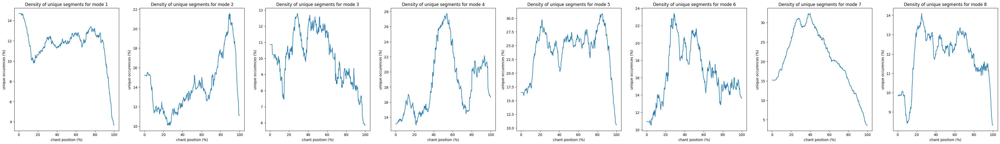

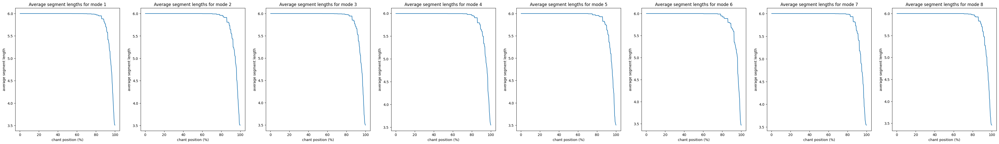

-------------------------------------------------------
------------------------------------------------------------------------


In [10]:
from src.utils.loader import prepare_dataset, load_ngram_segmentations
from src.eval.pipelines import evaluation_pipeline


# Get Data
_, y = prepare_dataset()
y_train, y_test = y[:9486].tolist(), y[9486:].tolist()
word_segmentations = load_ngram_segmentations(n=6)
train_segmentation, test_segmentation = word_segmentations[:9486], word_segmentations[9486:]
# Evaluate model
bacor_model = evaluation_pipeline(
    train_segmentation, y_train, test_segmentation, y_test,
    max_features_from_model = 100, include_additative = False, fe_occurence_coef=10)

INFO:root:Number of chants: 13551


/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:629: FutureWarning: The default value for `force_alpha` will change to `True` in 1.4. To suppress this warning, manually set the value of `force_alpha`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:635: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10. Use `force_alpha=True` to keep alpha unchanged.
  warnings.warn(
INFO:root:The SVC model was trained with 9486 training data and 9486 testing data.
INFO:root:From model approach - Selected features: 1000 (only 100 of them will be chosen)
INFO:root:From model approach Train data - First feature occurences: 704 , Last feature occurences: 63
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:629: FutureWarning: The default value for `force_alpha` will change to `True` in 1.4. To suppress this warning, manually set the value of `force_alpha`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/

------------------------------- Train Scores -------------------------------

		 bacor accuracy and f1
			 accuracy: 97.06%
			 f1: 97.01%

		 NB accuracy and f1
			 accuracy: 96.48%
			 f1: 96.51%

		 Perplexity
			 -1.000000

		 Vocabulary Size
			 size: 23395 unique segments

		 Average Segment Length
			 avgerage: 5.73 tones in one segment

		 Melody Justified With Words
			 words justification: 34.90% of segments
			 segments justification: 21.96% of segments
			 average justification: 28.43% of segments

		 Weighted Top Mode Frequency
			 wtmf: 72.04% of melodies

		 Weighted Unique Final Pitch Count
			 wufpc: 5.50 final pitches for a chant

		 Vocabulary Levenhstein Score
			 vls: 0.91 vocab diversity
------------- Modes Vocabulary Statistics -------------


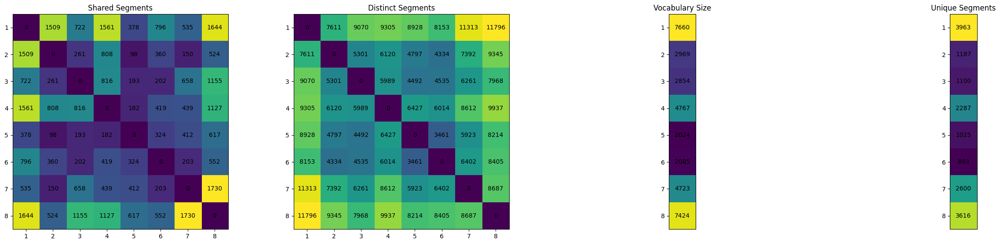

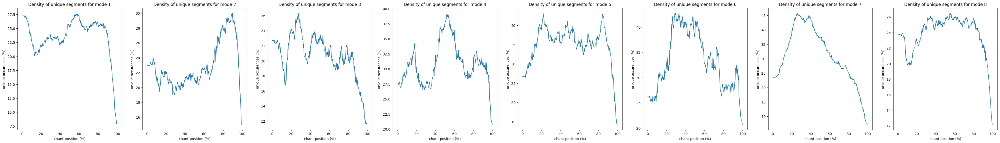

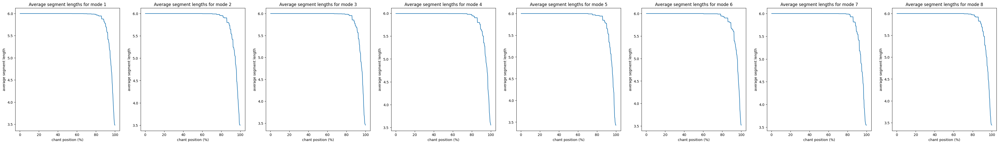

-------------------------------------------------------
----------------------------- Segments Occurences regarding the mode -----------------------------


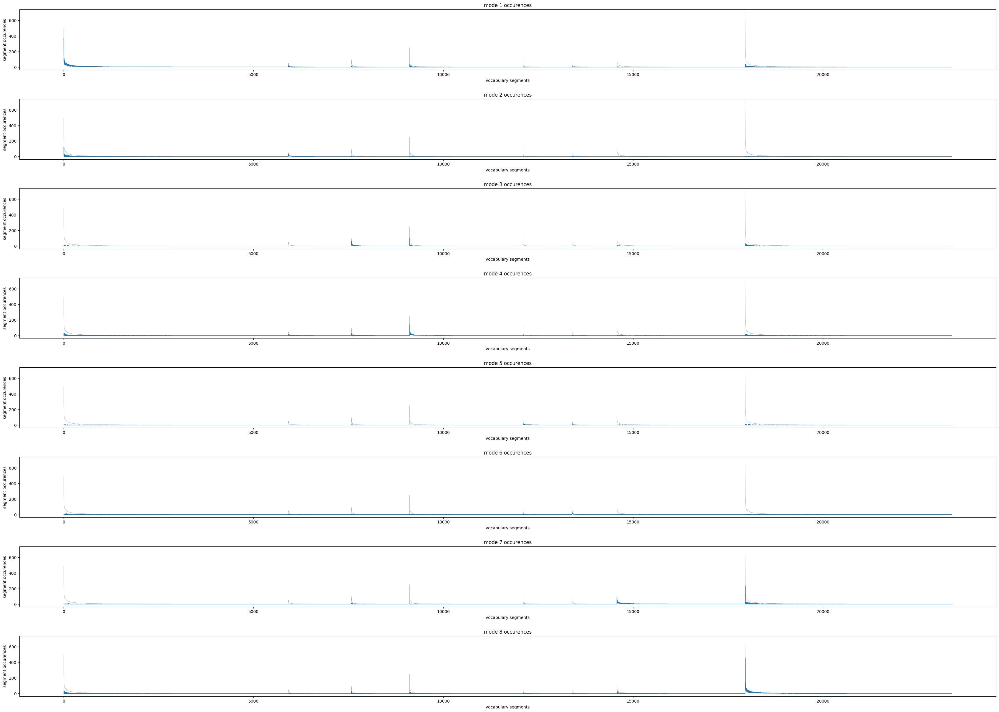

--------------------------------------------------------------------------------------------------
--------------------------------------------------------------------------






INFO:root:The SVC model was trained with 9486 training data and 4065 testing data.
INFO:root:From model approach - Selected features: 1000 (only 100 of them will be chosen)
INFO:root:From model approach Train data - First feature occurences: 704 , Last feature occurences: 63
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:629: FutureWarning: The default value for `force_alpha` will change to `True` in 1.4. To suppress this warning, manually set the value of `force_alpha`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/naive_bayes.py:635: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10. Use `force_alpha=True` to keep alpha unchanged.
  warnings.warn(
INFO:root:From model approach - reduced bacor accuracy: 80.76%, reduced bacor f1: 80.42% - reduced NB accuracy: 80.59%, reduced NB f1: 80.01%


------------------------------- Test Scores -------------------------------

		 bacor accuracy and f1
			 accuracy: 86.69%
			 f1: 86.33%

		 NB accuracy and f1
			 accuracy: 83.69%
			 f1: 84.24%

		 Perplexity
			 -1.000000

		 Vocabulary Size
			 size: 14192 unique segments

		 Average Segment Length
			 avgerage: 5.74 tones in one segment

		 Melody Justified With Phrases
			 mjww: -100.00% of segments

		 Melody Justified With Words
			 words justification: 34.87% of segments
			 segments justification: 22.07% of segments
			 average justification: 28.47% of segments

		 Weighted Top Mode Frequency
			 wtmf: 75.08% of melodies

		 Weighted Unique Final Pitch Count
			 wufpc: 5.54 final pitches for a chant

		 Vocabulary Levenhstein Score
			 vls: 0.91 vocab diversity
------------- Modes Vocabulary Statistics -------------


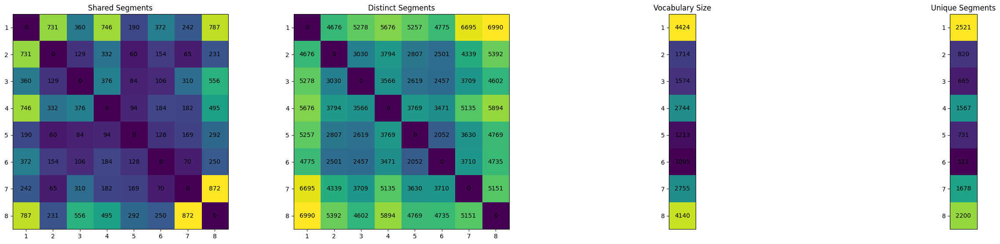

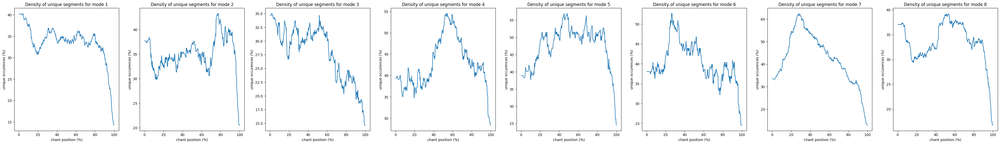

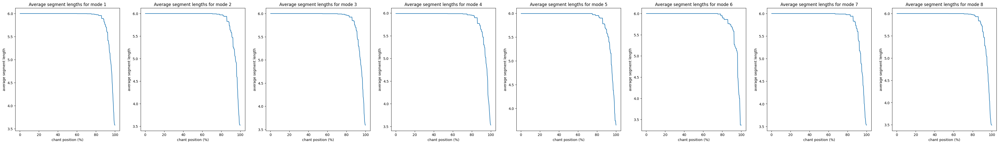

-------------------------------------------------------
----------------------------- Segments Occurences regarding the mode -----------------------------


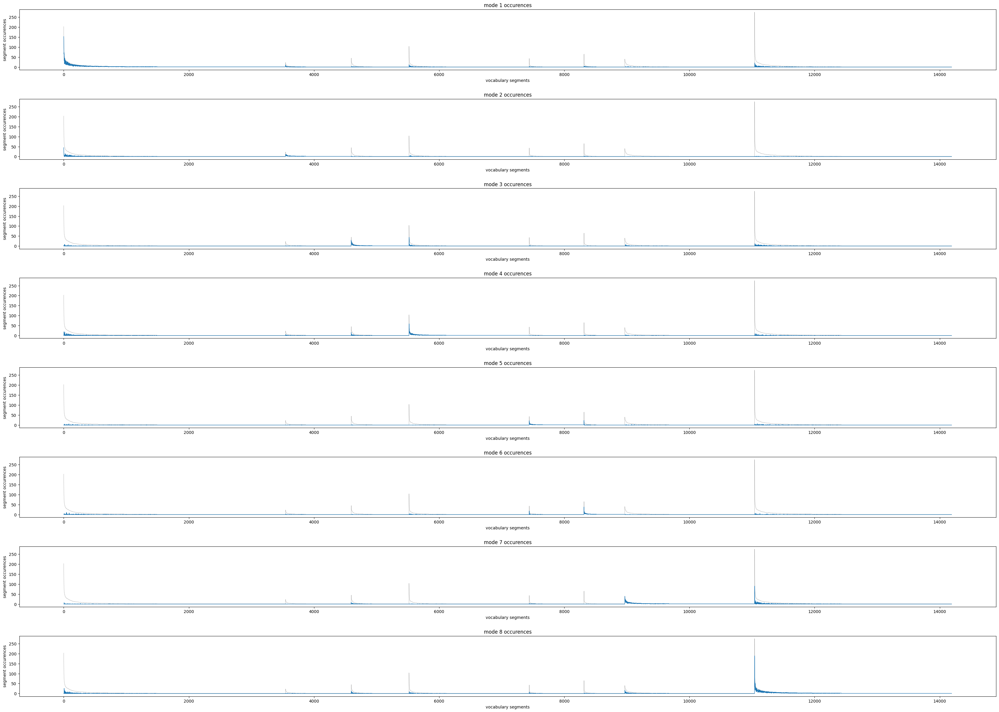

--------------------------------------------------------------------------------------------------
--------------------------------------------------------------------------




Top selected melodies - from model: ['g', 'gg', 'd', 'dd', 'hgg', 'edd', 'e', 'efgfed', 'fedd', 'ee', 'hgfghh', 'fghhgg', 'fgfedd', 'gfghhg', 'ghgfgg', 'ggkhgh', 'ddcfgf', 'fghgfg', 'fefgfe', 'hhgg', 'f', 'ghgfed', 'fedcdd', 'hgfefg', 'kkjhgh', 'ggkhhg', 'gghgfg', 'fghgfe', 'ghgfgf', 'dddcfg', 'hgfghg', 'fedefg', 'gfedd', 'hgfggh', 'ggghgf', 'efghhg', 'ghkkkk', 'dcdfed', 'ljlmll', 'fghfed', 'fgfedc', 'hhgfgh', 'ghhgg', 'gfedcd', 'gfefgf', 'ggg', 'fghhhg', 'kkkkkk', 'fee', 'ddcdfe', 'gfedee', 'defggg', 'hgfede', 'jhgg', 'gfee', 'fghghg', 'dcdefg', 'hkjhgg', 'hkjhgh', 'gjklml', 'ggjklm', 'ghgefg', 'ggfghg', 'gggghg', 'ghfedd', 'fedcdf', 'hjhgg', 'ff', 'hhhhhh', 'ghgfef', 'cddhkh', 'lljlml', 'hghgff', 'fghgff', 'ghghgf', 'fgghgf', 'fghggg', 'ggkjkl', 'cdd', 'hg', 'gefgfe', 'kjhghg', 'fghhhh', 'hgghgf', 'cdefed', '

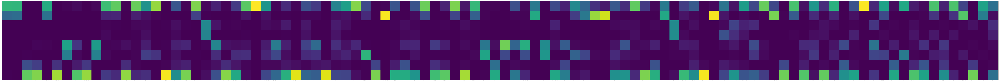

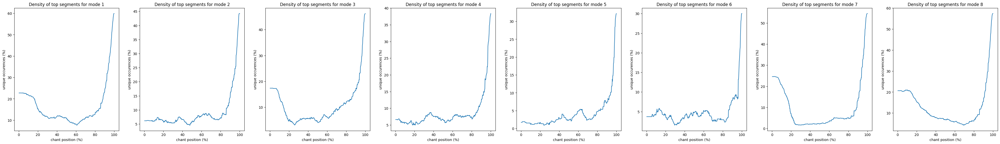





------------------------- Train + Test data charts ----------------------------
------------- Modes Vocabulary Statistics -------------


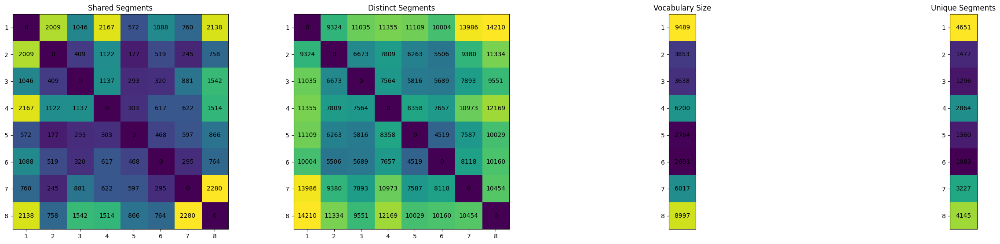

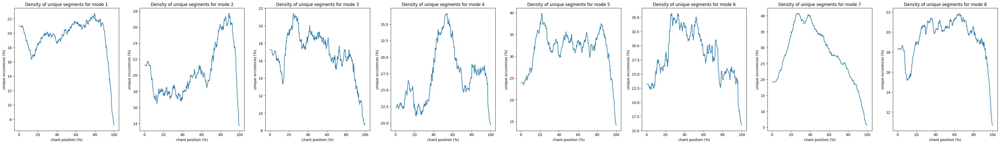

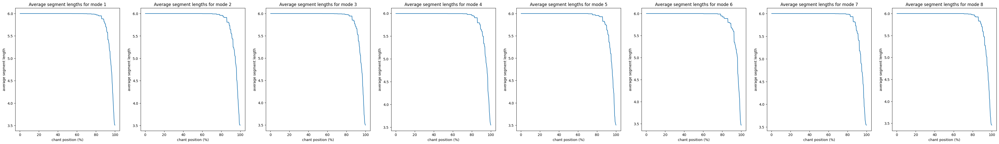

-------------------------------------------------------
------------------------------------------------------------------------


In [11]:
from src.utils.loader import prepare_dataset, load_ngram_segmentations
from src.eval.pipelines import evaluation_pipeline


# Get Data
_, y = prepare_dataset()
y_train, y_test = y[:9486].tolist(), y[9486:].tolist()
word_segmentations = load_ngram_segmentations(n=6, liquescents=True)
train_segmentation, test_segmentation = word_segmentations[:9486], word_segmentations[9486:]
# Evaluate model
bacor_model = evaluation_pipeline(
    train_segmentation, y_train, test_segmentation, y_test,
    max_features_from_model = 100, include_additative = False, fe_occurence_coef=10)